In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import NeuroSAGE as NS
import matplotlib
import numpy as np


font = {'size'   : 10}
matplotlib.rc('font', **font)

# read dataset
data = pd.read_csv("preprocessed_data_efeatures.csv")

data = data[data['protocol'] == 'fi']

data = data[['date', 'filename', 'file key', 'AP_amplitude', 'bias current',
     'AP_count', 'step current', 'stim dur', 'time stamp',
     'total current', 'state', 'slice id']]

# round numbers
data['bias current'] = data['bias current'].apply  ( lambda x: round(x/10.0)*10.0 )
data['step current'] = data['step current'].apply  ( lambda x: round(x/20.0)*20.0 )
data['total current'] = data['total current'].apply( lambda x: round(x/20.0)*20.0 )
                                                    
# elaborate time stamp
data['time stamp'] = data['time stamp'].apply( lambda x: x.split()[1].split('.')[0] )


# selection of traces
selection =  pd.read_csv('data_selection.csv')[['filename', 'file key']]
selection['mark'] = 1
data = data.merge(selection, on=['filename', 'file key'], how='left')
data[data['mark'].isnull()]['mark'] = 0
print (data.columns)

Index(['date', 'filename', 'file key', 'AP_amplitude', 'bias current',
       'AP_count', 'step current', 'stim dur', 'time stamp', 'total current',
       'state', 'slice id', 'mark'],
      dtype='object')


/tmp/ipykernel_62297/3720398597.py:33: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data[data['mark'].isnull()]['mark'] = 0


In [2]:
# set ap threshold line
ap_thresh = -20

In [3]:
def plot_data(data, f, data_selection, nplot=None):
    import math
    
    
    if nplot is None:
        nplot = data_selection.shape[0]
        
    data_selection.sort_values('step current', inplace=True)
    data_selection.sort_values('time stamp', inplace=True)
    
    ncol = 2
    nrow = round(math.ceil(nplot/ncol))

    fig, ax = plt.subplots(nrow, ncol)
    print('\n\nfilename:    ' + str(data_selection.iloc[0, 1].split('/')[1:])[1:-1].replace("'", '').replace(',', '    ') + '    bias current:' + data_selection.iloc[0, 4].astype(str) + ' pA')
    ax = ax.reshape((nrow, ncol))
    fig.set_size_inches(8.5, 4 * nrow)
    ap_amp = data_selection[(data_selection['filename'] == data_selection.iloc[0, 1]) & (data_selection['AP_count'] > 0)]['AP_amplitude']
    print ('  Avg. AP amplitude (mV)', round(ap_amp.mean(), 1))
    
    indices = []
    for i in range(nplot):
        k = data_selection.index[i]
        indices.append(k)
        filename = data_selection.loc[k, 'filename']
        file_key = data_selection.loc[k, 'file key']
        
        itrace = f.keys.index(file_key)
        trace = f.read_voltage_trace(itrace)
        hold_v = round(f.holding_voltage(itrace), 1)
        v_last = round(np.mean(trace[np.logical_and(trace[:, 0] >= 2700, trace[:, 0] <= 2800), 1]), 1)
        _ax = ax[int(i/ncol), i%ncol]
        if data_selection.loc[k, 'mark'] == 1:
            color = 'green'
        else:
            color = 'red'
        _ax.plot(trace[:,0], trace[:,1], color=color)
        
        _ax.set_title(file_key)
        s = 'step ' + data_selection.loc[k, 'step current'].astype(str) + ' pA' + \
                     '\ntime ' +  data_selection.loc[k, 'time stamp'] + \
                    '\nlast-100ms-volt. ' + str(v_last) + ' mV' + \
                    '\nAP amplitude ' + str( round( data_selection.loc[k,'AP_amplitude'], 1)) + ' mV' + \
                    '\nHolding volt. ' + str(hold_v) + ' mV'
        
        #if data_selection.loc[k, 'spike count'] > 0:
        s += '\nAP count ' + str( data_selection.loc[k, 'AP_count'] )
            
        _ax.annotate(s, (1800,-10))
        _ax.set_xlim([750,2850])
        _ax.set_ylim([-80,30])
        _ax.plot([0, 3000], [ap_thresh, ap_thresh])
    fig.tight_layout(pad=2.0)
#    click_plot = ClickPlot(fig, indices, selection)
#    return click_plot
    


#class ClickPlot:
#        def __init__(self, fig, info, click_list):
#                self.fig = fig
#                self.fig.canvas.mpl_connect('button_press_event', self.onClick)
#                self.info = info
#                self.click_list = click_list
#
#
#        def onClick(self, event):
#                if event.inaxes is None:
#                        return 
#                subplot_index = self.fig.axes.index(event.inaxes)
#                x = self.info[subplot_index]
#                if x not in self.click_list:
#                        self.click_list.add(x)
#                        self.fig.axes[subplot_index].get_lines()[0].set_color('green')
#                else:
#                        self.click_list.remove(x)
#                        self.fig.axes[subplot_index].get_lines()[0].set_color('red')
        
        
    
def run_plotting(data, neuron_index):
    click_plot = []
    
    # get the file set for each neuron
    file_set_table = data[['date', 'filename', 'slice id', 'state']].drop_duplicates()

    # neurons
    neurons = file_set_table.groupby(['date', 'slice id'])

    _neurons_list = list( neurons.groups.items() ) # convert to a list, so we can retrive by an integer id

    # get records containing the file set
    _file_set = file_set_table.loc[_neurons_list[neuron_index][1], 'filename'].values

    # neuron informations
    print ('Neuron information:')
    print (file_set_table.loc[_neurons_list[neuron_index][1], ['date', 'slice id', 'state']].drop_duplicates())

    # we retrieve the recordings by file
    for _file in _file_set:
        f = NS.FileReader(_file, filter_flag=True)
        # group by bias current
        _data = data[data['filename'] == _file]
        for _, g in _data.groupby('bias current'):
            plot_data(data, f, g)
#            click_plot.append(
#                plot_data(data, f, g)
#            )
            plt.show()
            print ('\n\n')
            # plot a batch of traces
    
#    return click_plot
            
                   

control
-----------------------------------------------------------------------------------------
Neuron information:
           date  slice id    state
621  2018-02-13  Slice1c2  control


filename:    2018-02-13_NS     2018-02-13 Slice1c2fI.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) 65.2


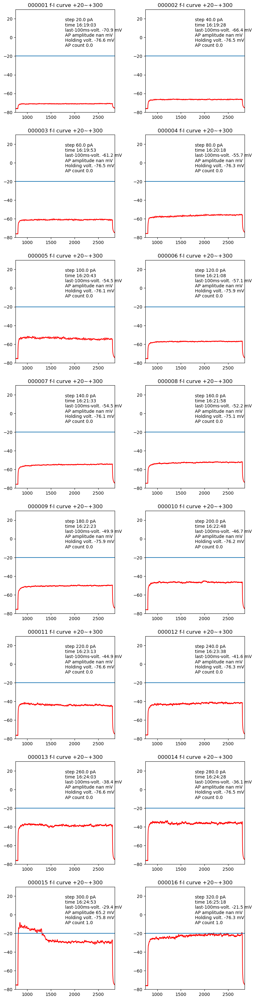






filename:    2018-02-13_NS     2018-02-13 Slice1c2fI.hdf5    bias current:40.0 pA
  Avg. AP amplitude (mV) 61.3


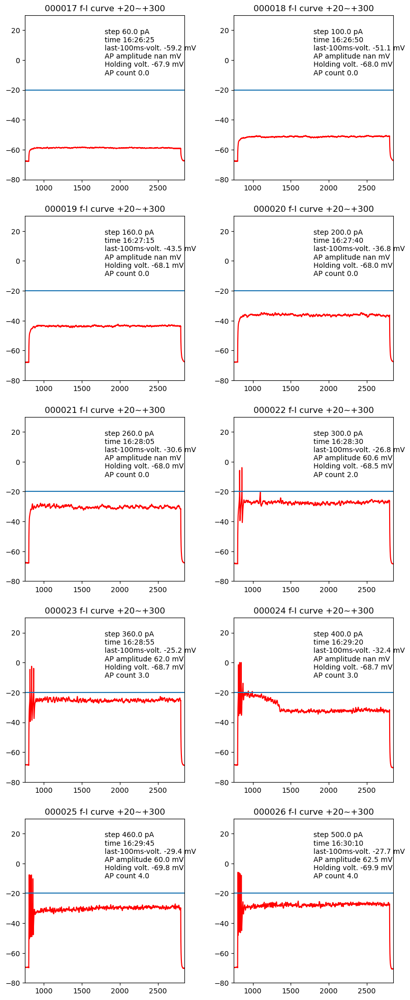




Neuron information:
           date  slice id    state
647  2018-02-21  Slice1c2  control


filename:    2018-02-21_NS     2018-02-21 Slice1c2fI.hdf5    bias current:40.0 pA
  Avg. AP amplitude (mV) nan


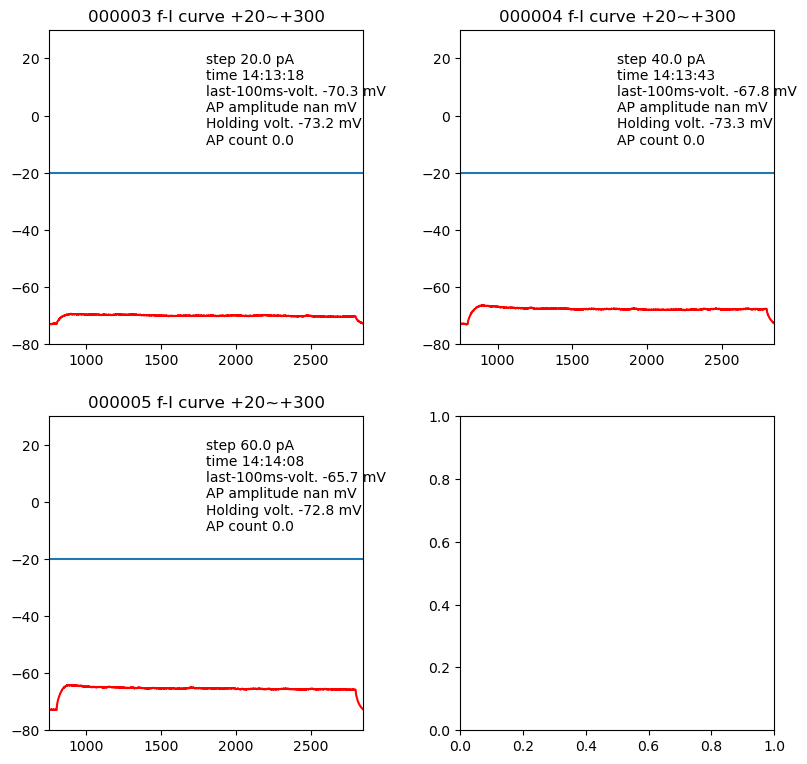






filename:    2018-02-21_NS     2018-02-21 Slice1c2fI.hdf5    bias current:50.0 pA
  Avg. AP amplitude (mV) 52.4


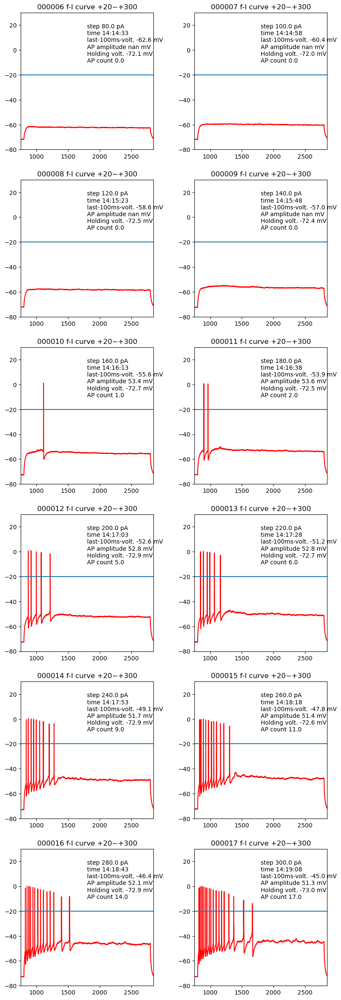






filename:    2018-02-21_NS     2018-02-21 Slice1c2fI_2.hdf5    bias current:60.0 pA
  Avg. AP amplitude (mV) 49.6


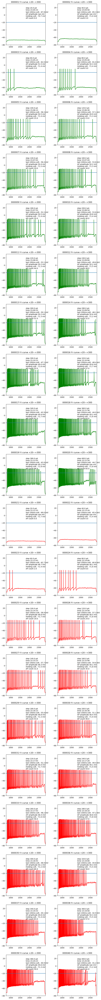




Neuron information:
           date  slice id    state
702  2018-02-21  Slice1c3  control


filename:    2018-02-21_NS     2018-02-21 Slice1c3fI.hdf5    bias current:60.0 pA
  Avg. AP amplitude (mV) 47.6


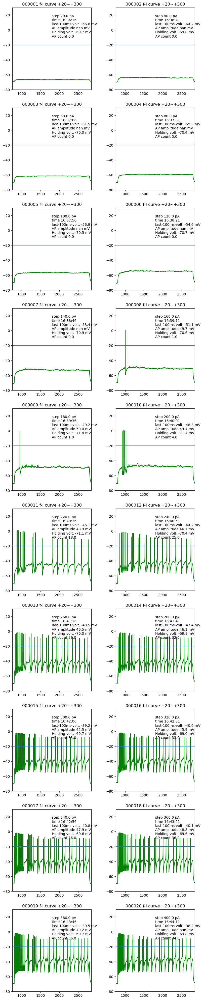




Neuron information:
           date  slice id    state
722  2018-03-21  Slice1c2  control


filename:    2018-03-21_NS     2018-03-21 Slice1c2 fI.hdf5    bias current:30.0 pA
  Avg. AP amplitude (mV) 42.8


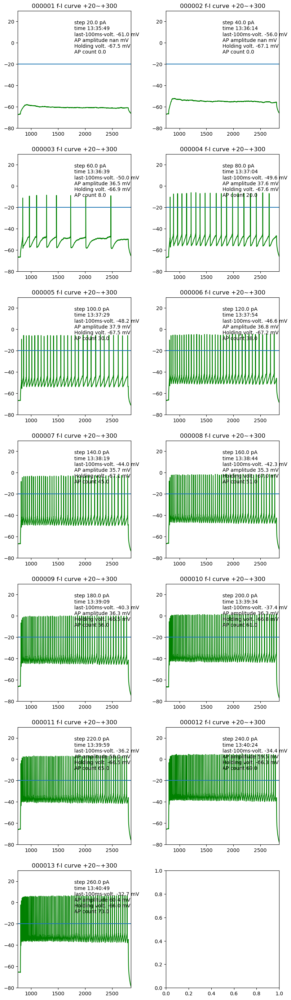






filename:    2018-03-21_NS     2018-03-21 Slice1c2 TBurst.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) nan


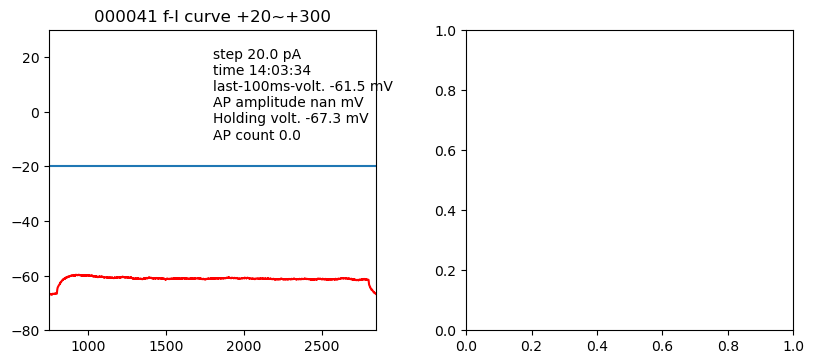




Neuron information:
           date  slice id    state
736  2018-06-01  Slice1c1  control


filename:    2018-06-01_NS     2018-06-01 Slice1c1 fI.hdf5    bias current:100.0 pA
  Avg. AP amplitude (mV) 48.1


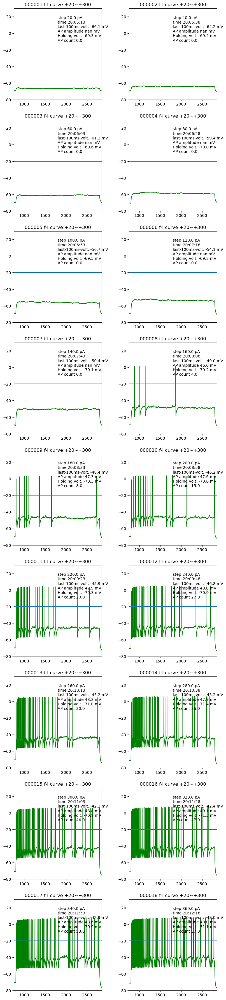




Neuron information:
           date  slice id    state
754  2018-06-06  Slice1c1  control


filename:    2018-06-06_NS     2018-06-06 Slice1c1 fI_3.hdf5    bias current:100.0 pA
  Avg. AP amplitude (mV) 57.7


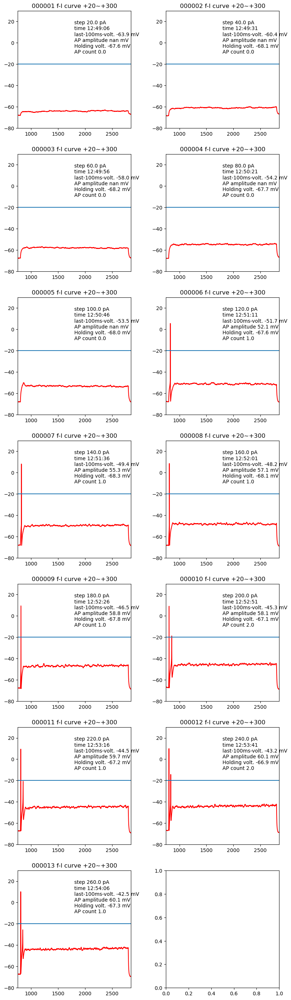






filename:    2018-06-06_NS     2018-06-06 Slice1c1 fI_2.hdf5    bias current:80.0 pA
  Avg. AP amplitude (mV) 61.2


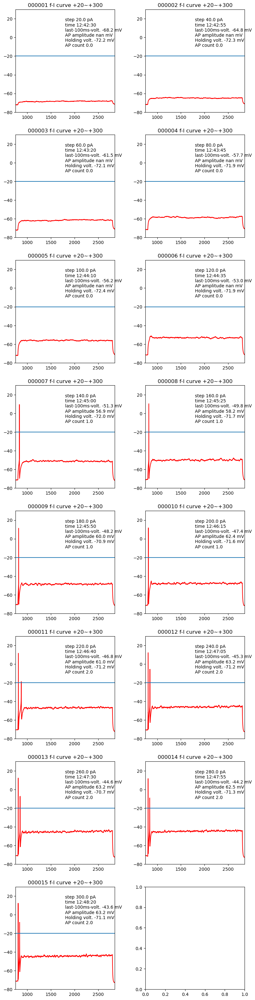






filename:    2018-06-06_NS     2018-06-06 Slice1c1 fI.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) nan


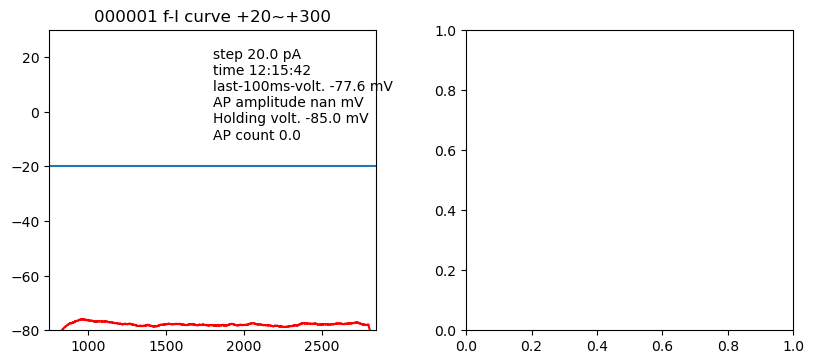






filename:    2018-06-06_NS     2018-06-06 Slice1c1 fI.hdf5    bias current:80.0 pA
  Avg. AP amplitude (mV) 58.5


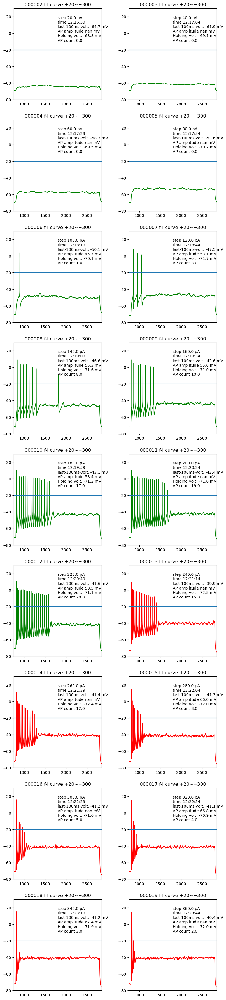




Neuron information:
           date  slice id    state
801  2018-06-06  Slice2c1  control


filename:    2018-06-06_NS     2018-06-06 Slice2c1 fI.hdf5    bias current:100.0 pA
  Avg. AP amplitude (mV) nan


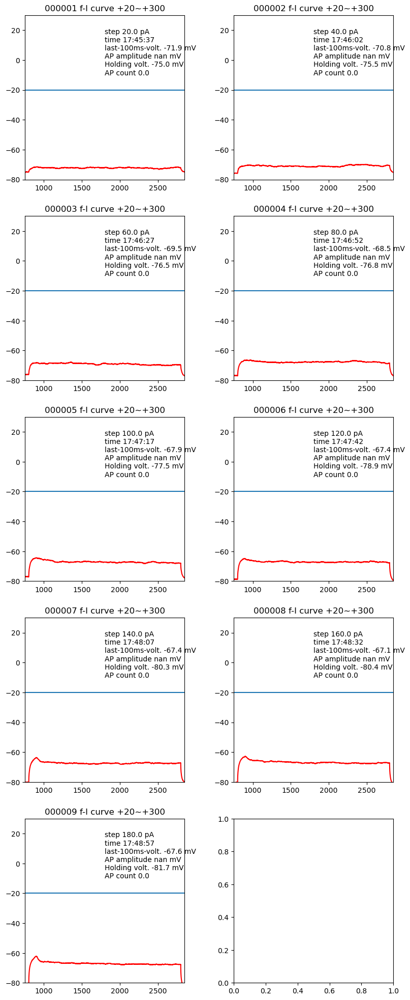






filename:    2018-06-06_NS     2018-06-06 Slice2c1 fI.hdf5    bias current:200.0 pA
  Avg. AP amplitude (mV) 55.7


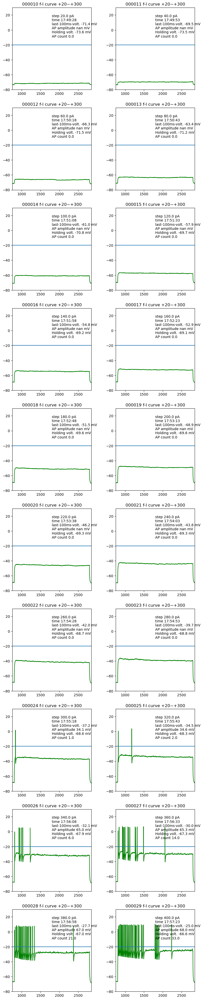






filename:    2018-06-06_NS     2018-06-06 Slice2c1 fI_2.hdf5    bias current:180.0 pA
  Avg. AP amplitude (mV) 61.4


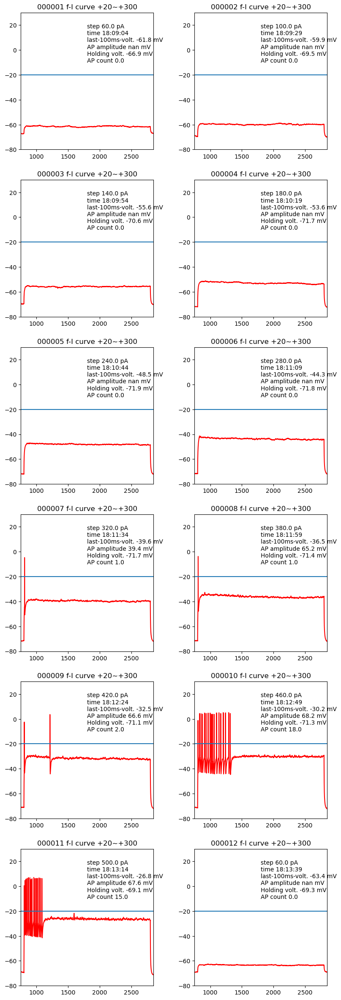




Neuron information:
           date  slice id    state
842  2018-06-22  Slice1c5  control


filename:    2018-06-22_NS     2018-06-22 Slice1c5 fI_2.hdf5    bias current:100.0 pA
  Avg. AP amplitude (mV) 58.3


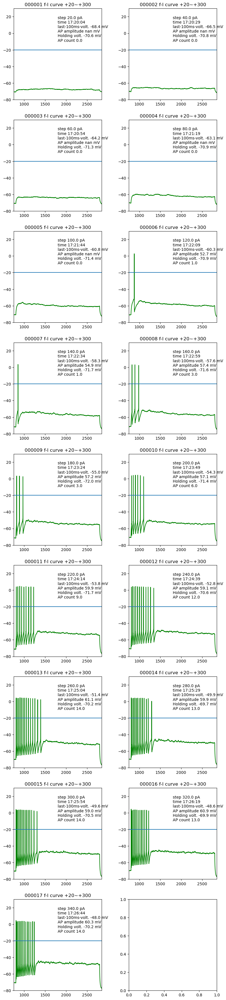






filename:    2018-06-22_NS     2018-06-22 Slice1c5 fI.hdf5    bias current:-20.0 pA
  Avg. AP amplitude (mV) 59.3


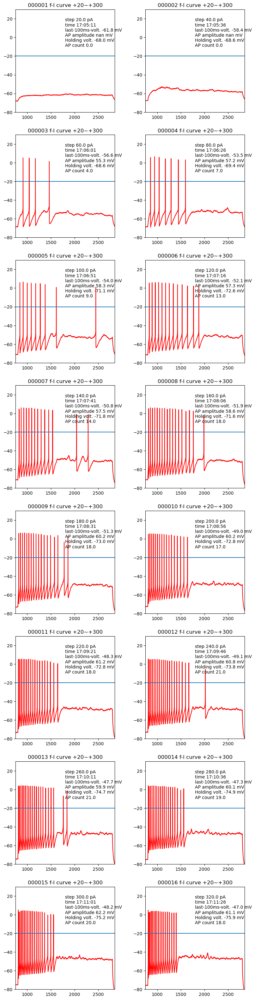




Neuron information:
           date  slice id    state
875  2018-06-22  Slice2c1  control


filename:    2018-06-22_NS     2018-06-22 Slice2c1 fI_2.hdf5    bias current:40.0 pA
  Avg. AP amplitude (mV) 51.2


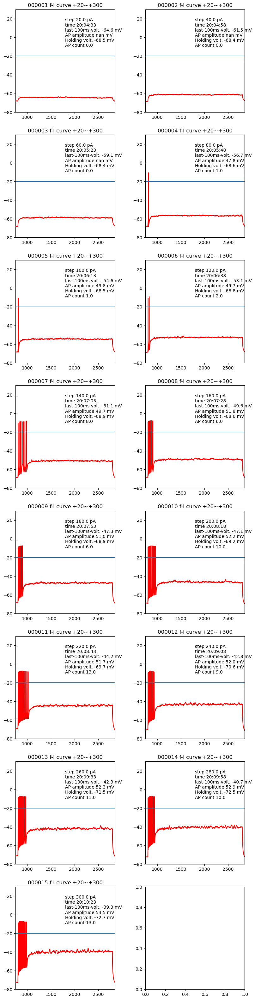






filename:    2018-06-22_NS     2018-06-22 Slice2c1 fI.hdf5    bias current:50.0 pA
  Avg. AP amplitude (mV) 54.2


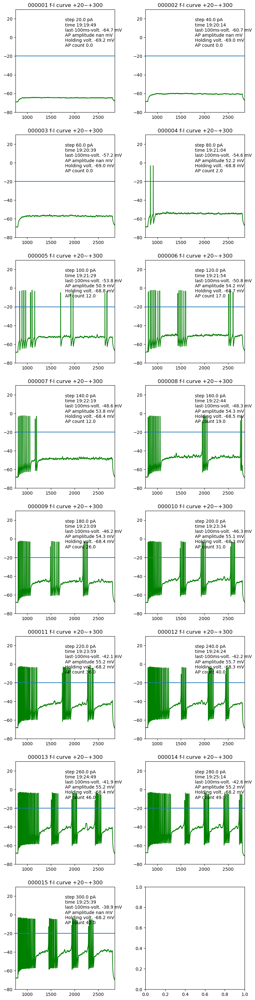




Neuron information:
           date  slice id    state
905  2018-06-22  Slice3c2  control


filename:    2018-06-22_NS     2018-06-22 Slice3c2fI.hdf5    bias current:30.0 pA
  Avg. AP amplitude (mV) 63.6


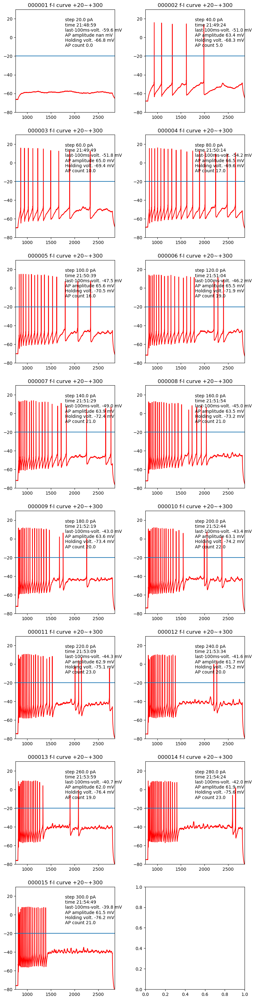






filename:    2018-06-22_NS     2018-06-22 Slice3c2fI.hdf5    bias current:50.0 pA
  Avg. AP amplitude (mV) 63.6


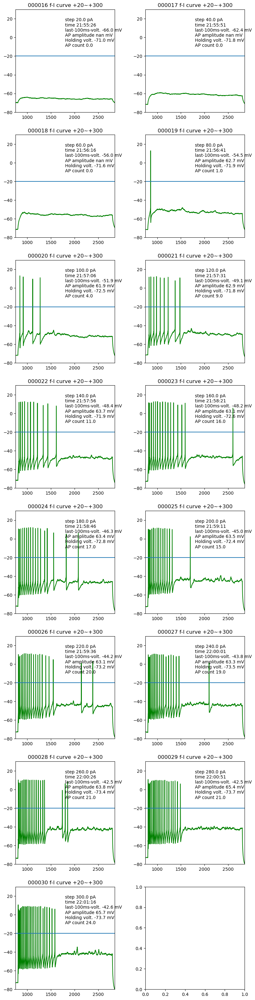




Neuron information:
           date  slice id    state
935  2018-07-16  Slice2c1  control


filename:    2018-07-16_NS     2018-07-16 Slice2c1 fI.hdf5    bias current:50.0 pA
  Avg. AP amplitude (mV) 60.4


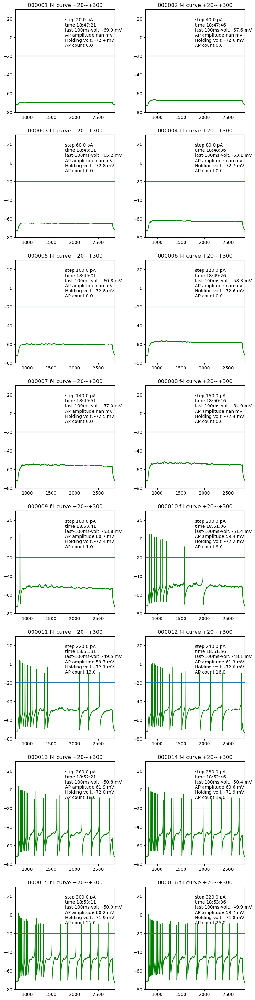






filename:    2018-07-16_NS     2018-07-16 Slice2c1 fI_2.hdf5    bias current:50.0 pA
  Avg. AP amplitude (mV) 51.1


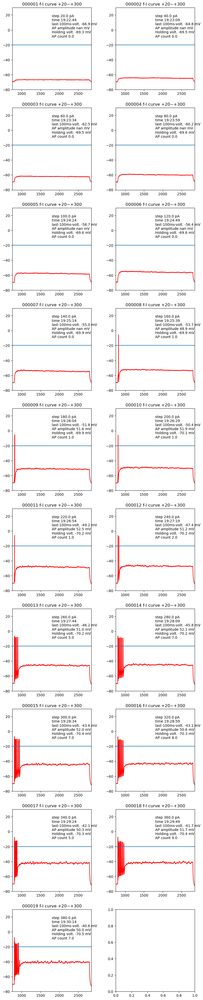




Neuron information:
           date  slice id    state
970  2019-02-08  Slice2c1  control


filename:    2019-02-08_NS     2019-02-08 Slice2c1.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) 68.8


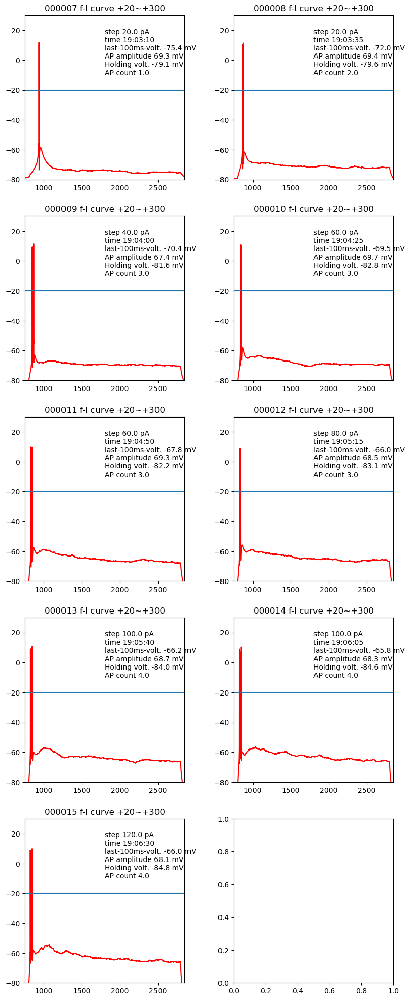






filename:    2019-02-08_NS     2019-02-08 Slice2c1.hdf5    bias current:60.0 pA
  Avg. AP amplitude (mV) 66.0


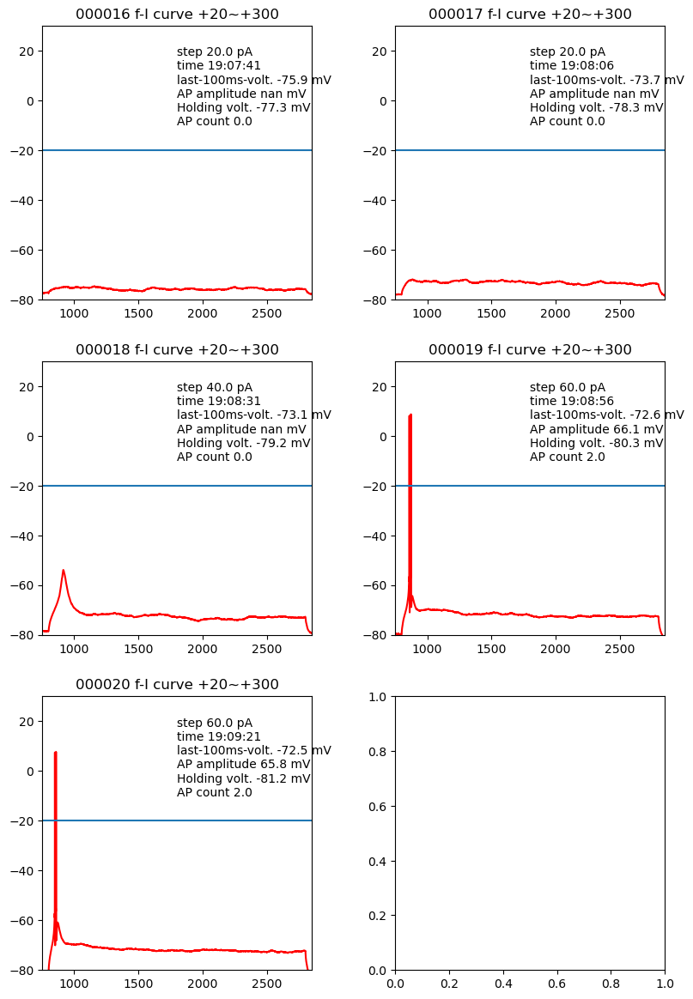






filename:    2019-02-08_NS     2019-02-08 Slice2c1.hdf5    bias current:100.0 pA
  Avg. AP amplitude (mV) 65.4


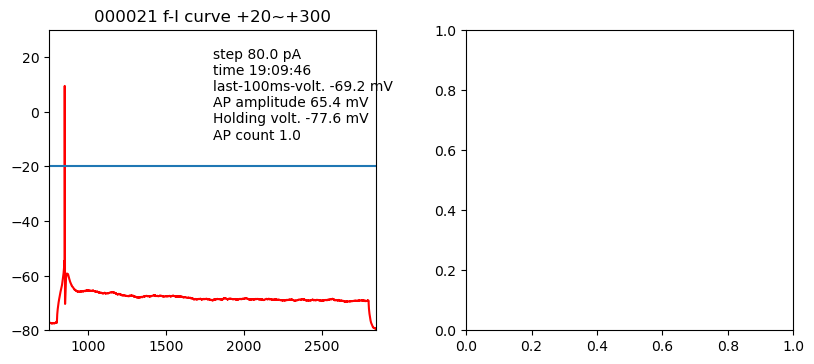






filename:    2019-02-08_NS     2019-02-08 Slice2c1.hdf5    bias current:200.0 pA
  Avg. AP amplitude (mV) 48.4


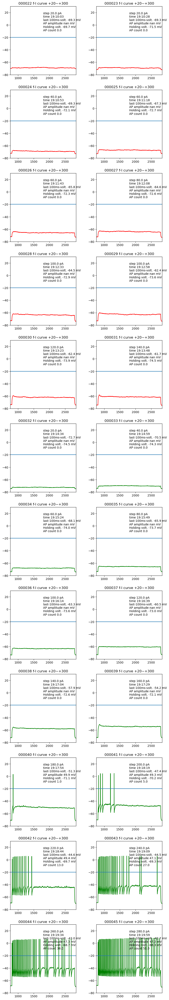




Neuron information:
            date  slice id    state
1009  2019-03-01  Slice2c1  control


filename:    2019-03-01_NS     2019-03-01 Slice2c1.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) 63.9


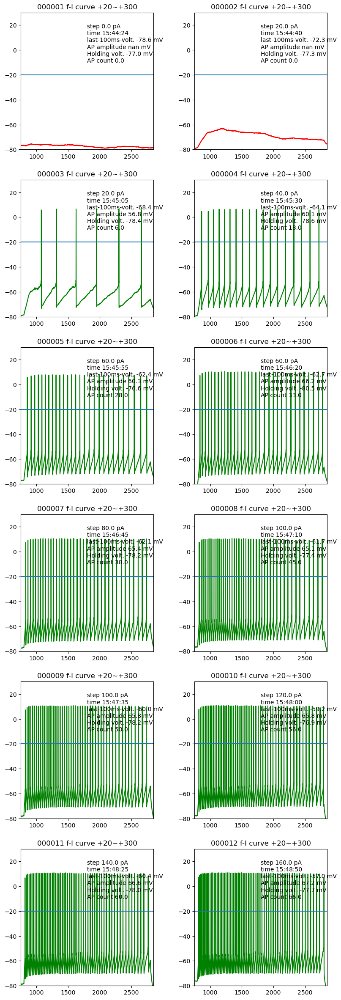




Neuron information:
            date  slice id    state
1021  2019-04-02  Slice2c1  control


filename:    2019-04-02_NS     2019-04-02 Slice2c1.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) 45.9


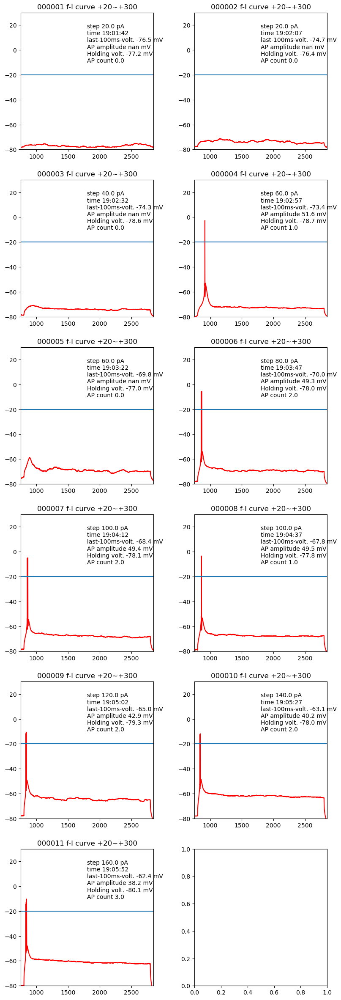






filename:    2019-04-02_NS     2019-04-02 Slice2c1.hdf5    bias current:60.0 pA
  Avg. AP amplitude (mV) 35.2


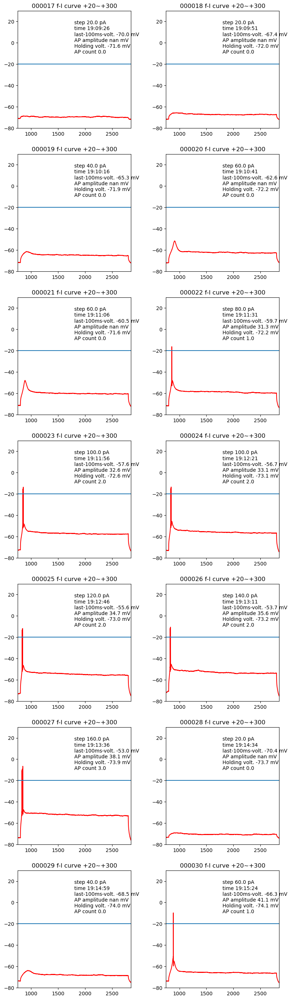






filename:    2019-04-02_NS     2019-04-02 Slice2c1.hdf5    bias current:80.0 pA
  Avg. AP amplitude (mV) 41.8


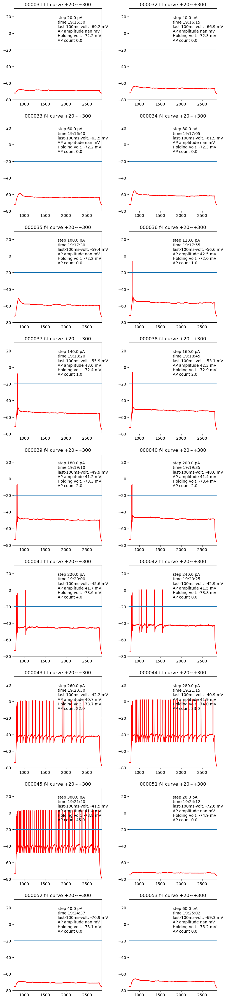






filename:    2019-04-02_NS     2019-04-02 Slice2c1.hdf5    bias current:90.0 pA
  Avg. AP amplitude (mV) nan


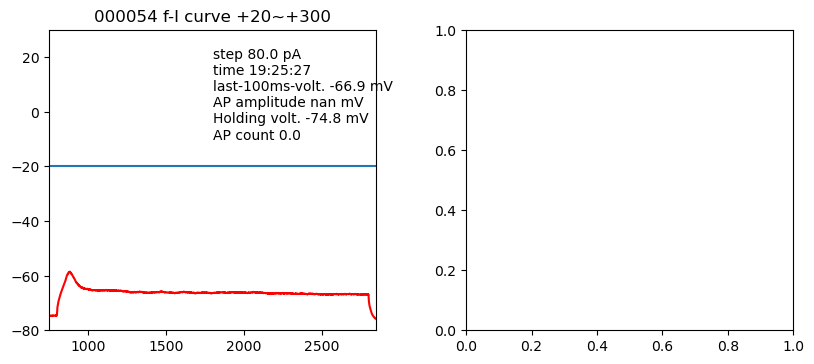






filename:    2019-04-02_NS     2019-04-02 Slice2c1.hdf5    bias current:100.0 pA
  Avg. AP amplitude (mV) 49.0


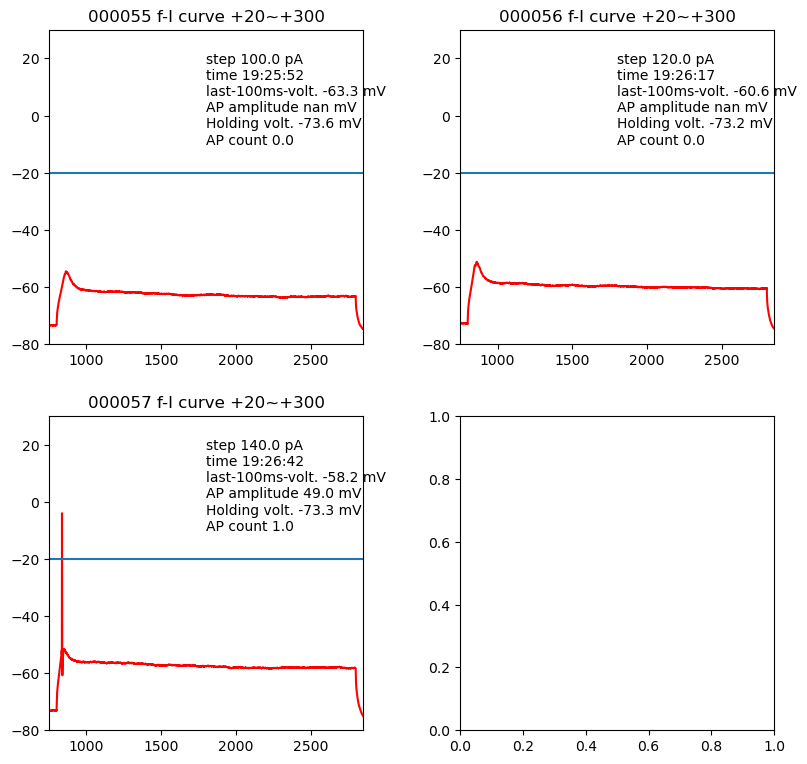




Neuron information:
            date  slice id    state
1068  2019-04-09  Slice2c1  control


filename:    2019-04-09_NS     2019-04-09 Slice2c1.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) 69.3


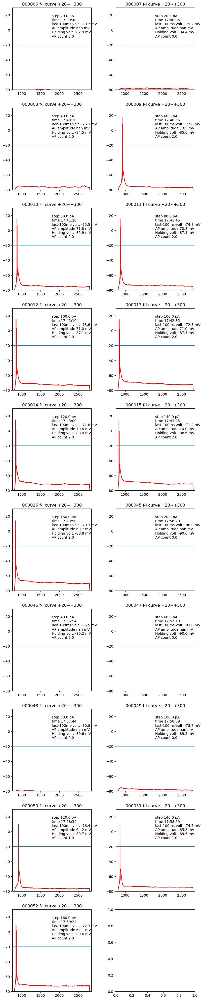






filename:    2019-04-09_NS     2019-04-09 Slice2c1.hdf5    bias current:120.0 pA
  Avg. AP amplitude (mV) nan


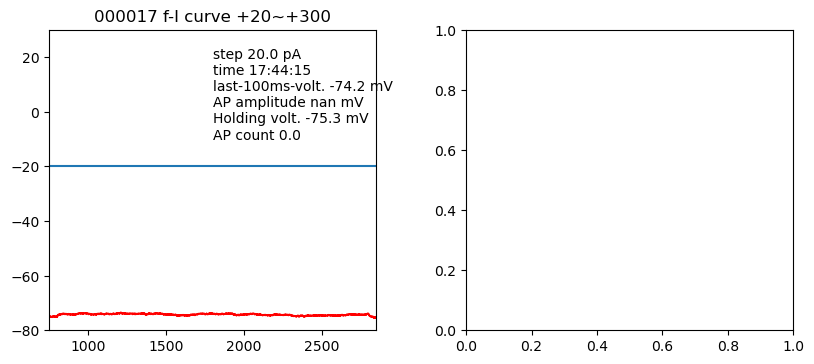






filename:    2019-04-09_NS     2019-04-09 Slice2c1.hdf5    bias current:160.0 pA
  Avg. AP amplitude (mV) 66.7


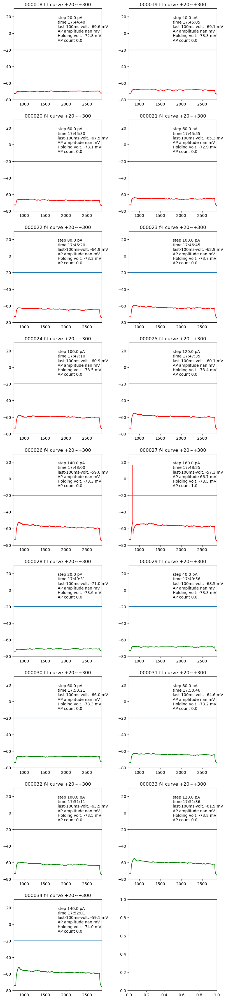






filename:    2019-04-09_NS     2019-04-09 Slice2c1.hdf5    bias current:170.0 pA
  Avg. AP amplitude (mV) 63.9


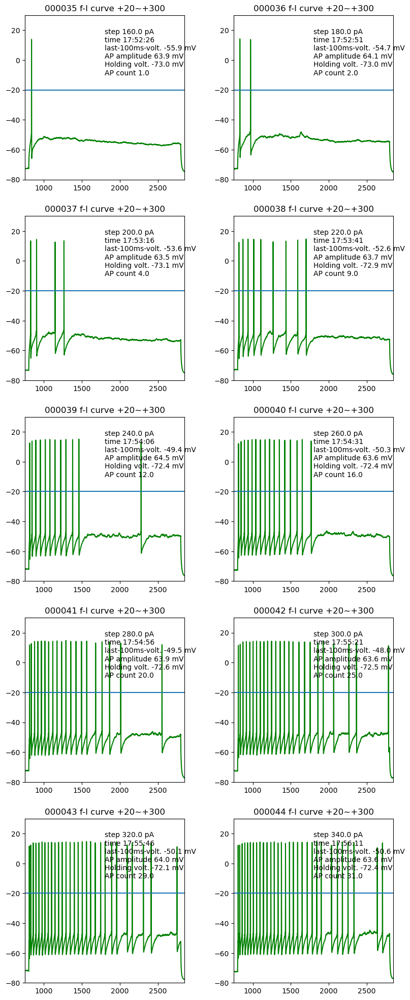




Neuron information:
            date  slice id    state
1115  2019-04-15  Slice1c1  control


filename:    2019-04-15_NS     2019-04-15 Slice1c1.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) 65.2


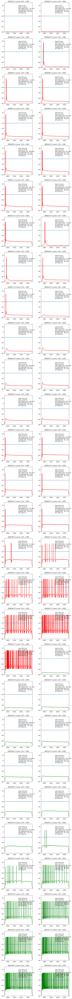






filename:    2019-04-15_NS     2019-04-15 Slice1c1.hdf5    bias current:30.0 pA
  Avg. AP amplitude (mV) 60.4


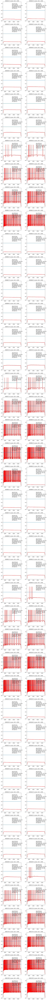






filename:    2019-04-15_NS     2019-04-15 Slice1c1.hdf5    bias current:40.0 pA
  Avg. AP amplitude (mV) 60.0


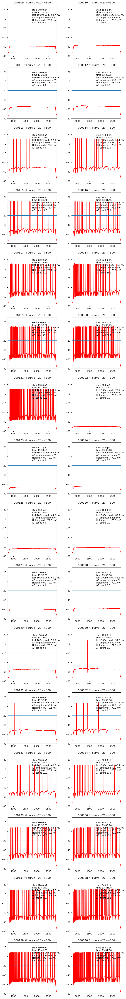




Neuron information:
            date  slice id    state
1289  2019-04-15  Slice2c1  control


filename:    2019-04-15_NS     2019-04-15 Slice2c1.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) 67.6


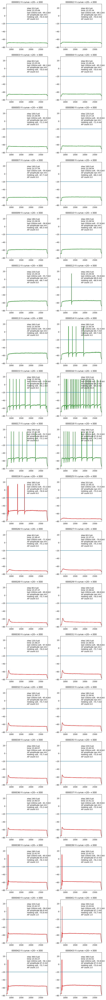






filename:    2019-04-15_NS     2019-04-15 Slice2c1.hdf5    bias current:30.0 pA
  Avg. AP amplitude (mV) 67.4


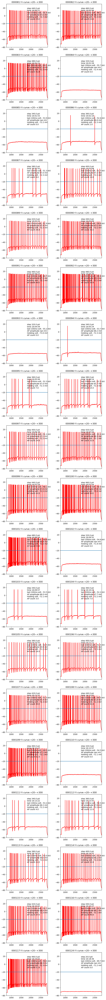






filename:    2019-04-15_NS     2019-04-15 Slice2c1.hdf5    bias current:40.0 pA
  Avg. AP amplitude (mV) 65.8


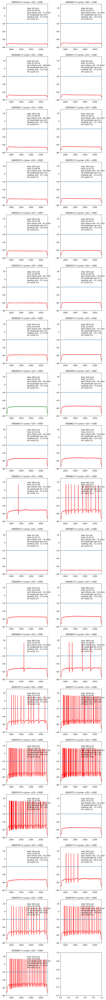




Neuron information:
            date  slice id    state
1402  2019-05-09  Slice1c1  control


filename:    2019-05-09_NS     2019-05-09 Slice1c1.hdf5    bias current:-20.0 pA
  Avg. AP amplitude (mV) 54.0


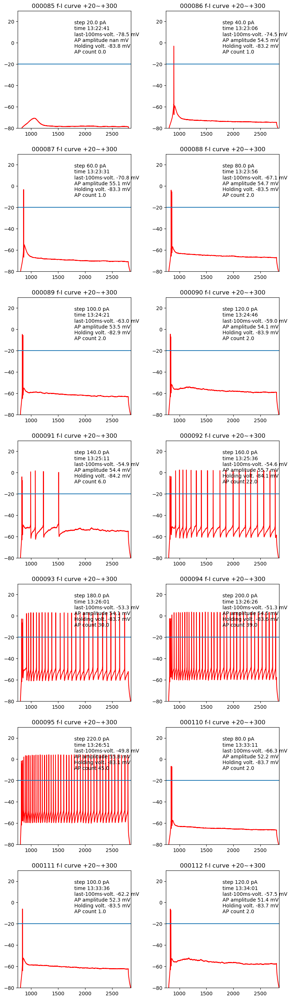






filename:    2019-05-09_NS     2019-05-09 Slice1c1.hdf5    bias current:-10.0 pA
  Avg. AP amplitude (mV) 52.3


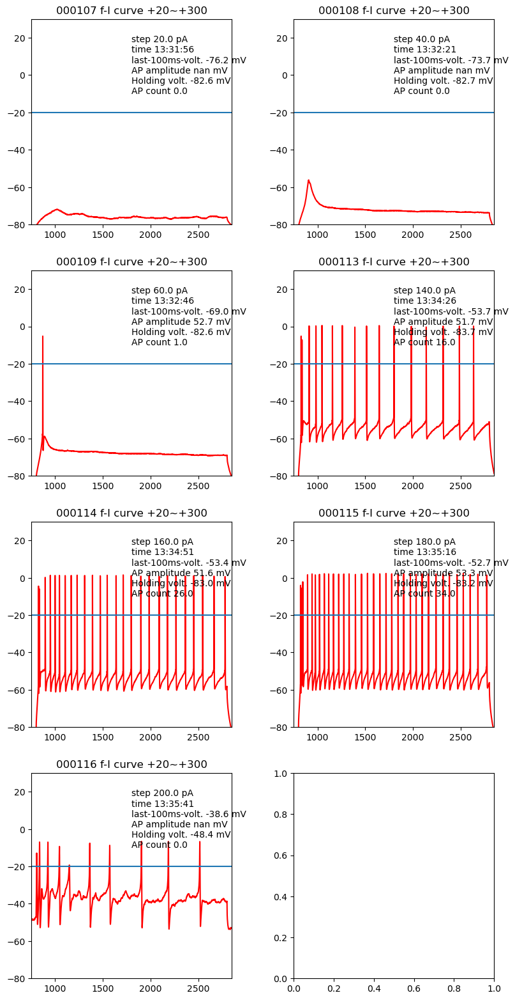






filename:    2019-05-09_NS     2019-05-09 Slice1c1.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) 61.7


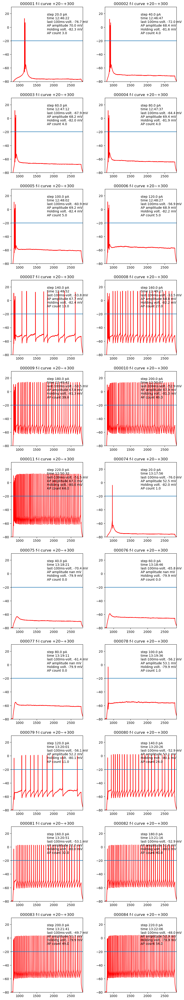






filename:    2019-05-09_NS     2019-05-09 Slice1c1.hdf5    bias current:30.0 pA
  Avg. AP amplitude (mV) 55.6


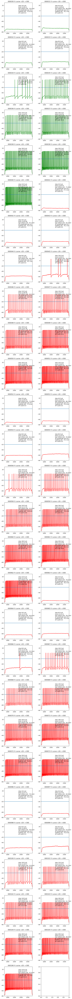




Neuron information:
            date  slice id    state
1500  2019-05-09  Slice2c2  control


filename:    2019-05-09_NS     2019-05-09 Slice2c2.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) 78.1


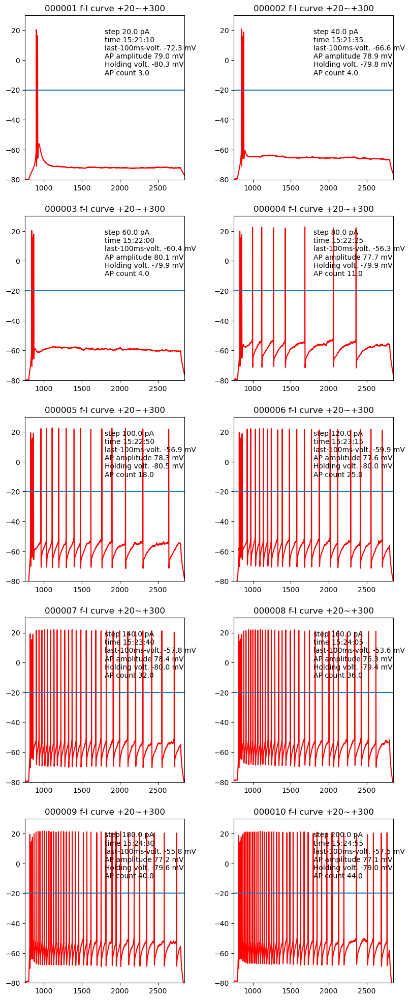






filename:    2019-05-09_NS     2019-05-09 Slice2c2.hdf5    bias current:10.0 pA
  Avg. AP amplitude (mV) 78.0


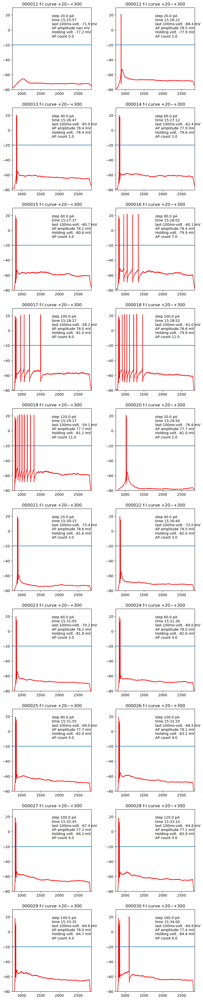






filename:    2019-05-09_NS     2019-05-09 Slice2c2.hdf5    bias current:60.0 pA
  Avg. AP amplitude (mV) 76.3


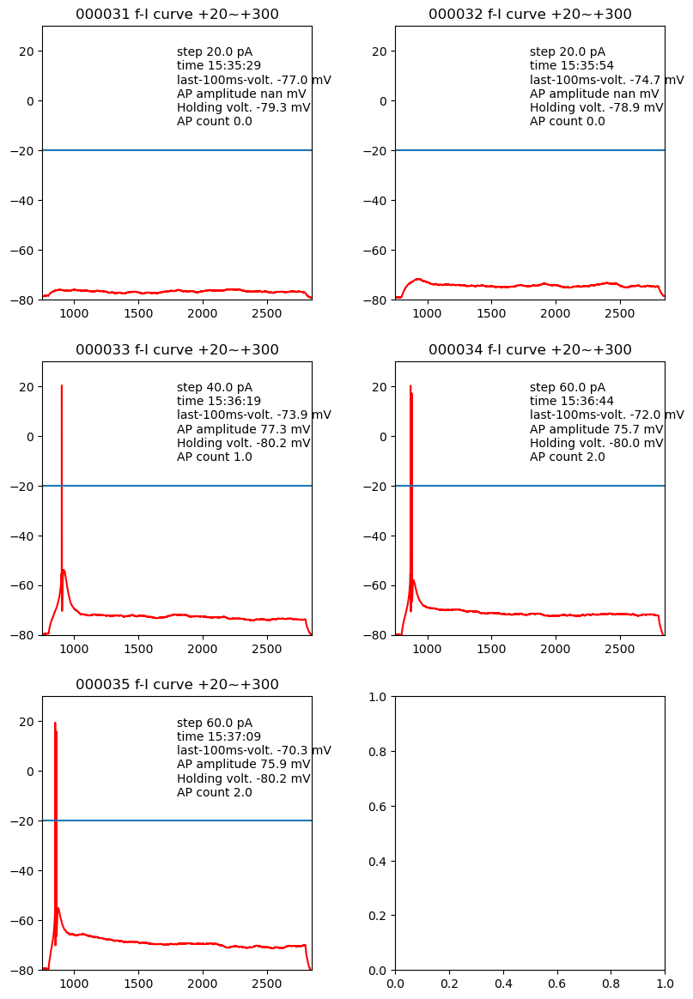






filename:    2019-05-09_NS     2019-05-09 Slice2c2.hdf5    bias current:70.0 pA
  Avg. AP amplitude (mV) 77.7


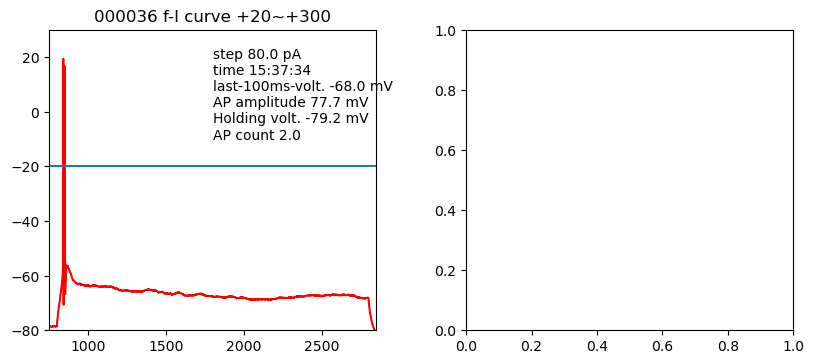






filename:    2019-05-09_NS     2019-05-09 Slice2c2.hdf5    bias current:80.0 pA
  Avg. AP amplitude (mV) 77.3


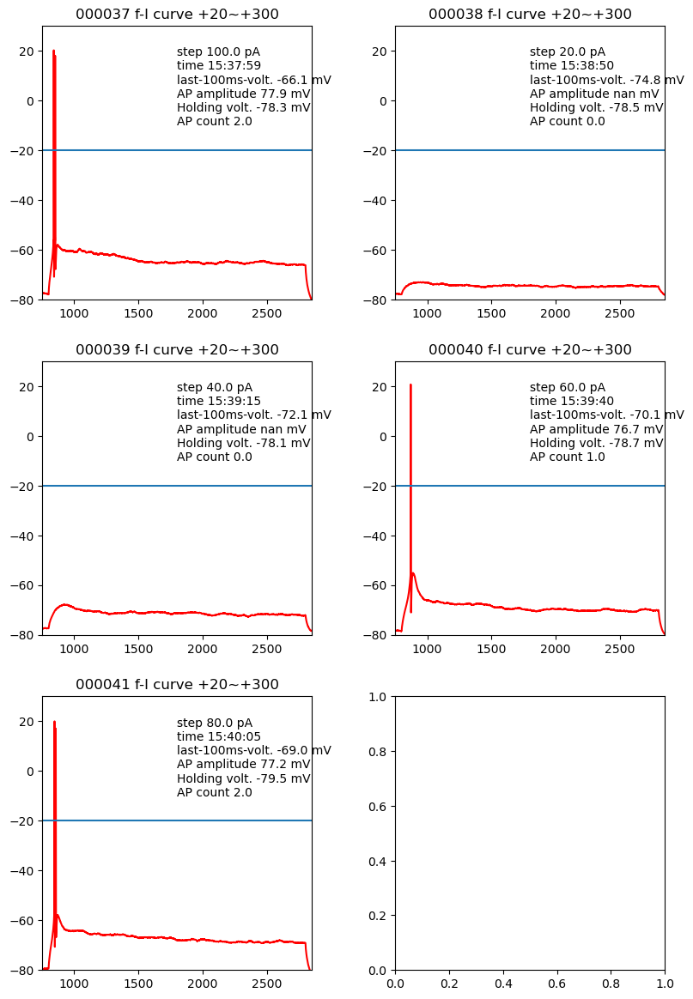






filename:    2019-05-09_NS     2019-05-09 Slice2c2.hdf5    bias current:90.0 pA
  Avg. AP amplitude (mV) 77.2


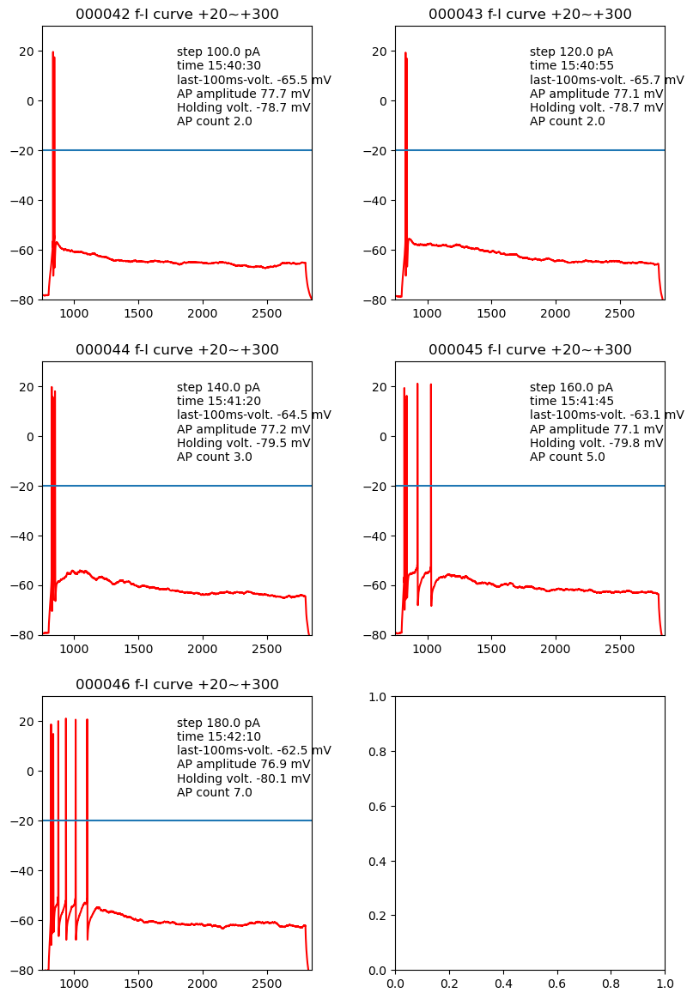






filename:    2019-05-09_NS     2019-05-09 Slice2c2.hdf5    bias current:100.0 pA
  Avg. AP amplitude (mV) 77.4


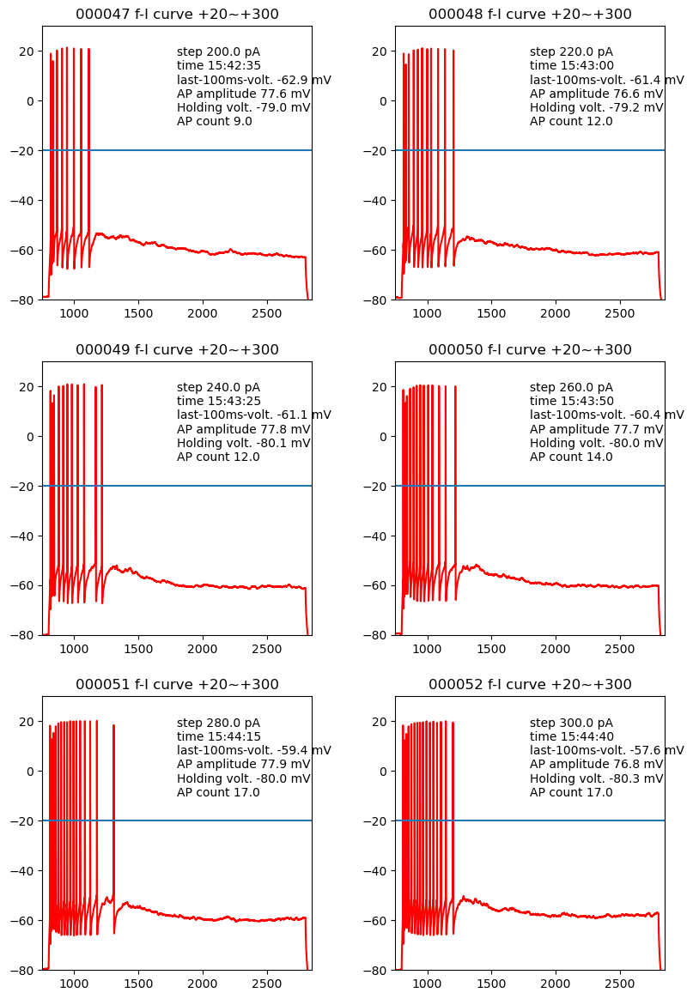






filename:    2019-05-09_NS     2019-05-09 Slice2c2.hdf5    bias current:130.0 pA
  Avg. AP amplitude (mV) 77.4


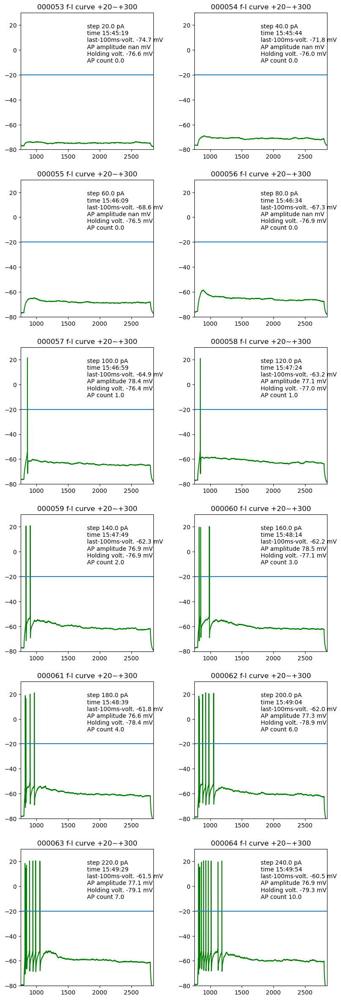






filename:    2019-05-09_NS     2019-05-09 Slice2c2.hdf5    bias current:150.0 pA
  Avg. AP amplitude (mV) 76.4


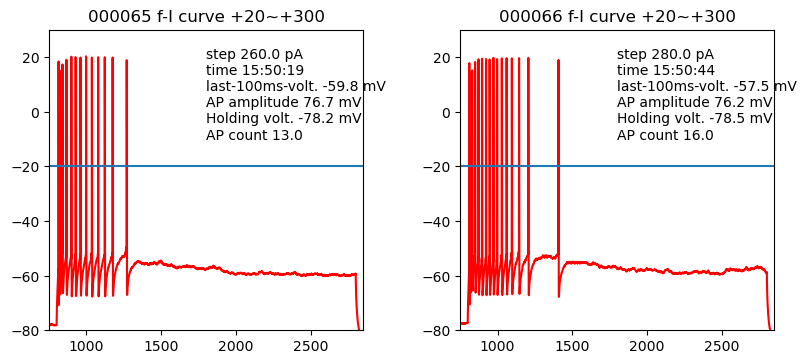




-----------------------------------------------------------------------------------------




In [4]:
# neuron index
print ('control')
print ('-----------------------------------------------------------------------------------------')
data_ctl = data[data['state'] == 'control']
n = data_ctl[['date', 'slice id']].drop_duplicates().shape[0]
for i in range(n):
    run_plotting(data_ctl, i)
print ('-----------------------------------------------------------------------------------------\n\n')

6ohda
-----------------------------------------------------------------------------------------
Neuron information:
           date  slice id  state
209  2018-01-05  Slice1c2  6ohda


filename:    2018-01-05_NS     2018-01-05 Slice1c2fI.hdf5    bias current:70.0 pA
  Avg. AP amplitude (mV) 55.2


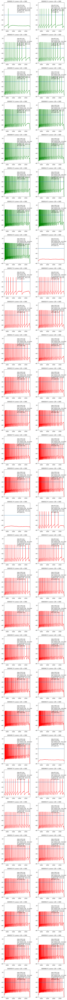




Neuron information:
           date  slice id  state
269  2018-03-30  Slice1c2  6ohda


filename:    2018-03-30_NS     2018-03-30 Slice1c2fI.hdf5    bias current:50.0 pA
  Avg. AP amplitude (mV) 44.2


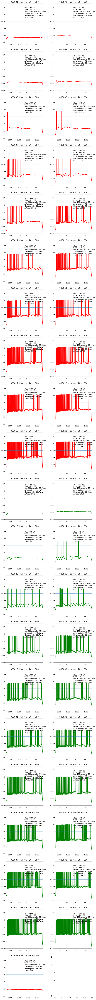




Neuron information:
           date  slice id  state
310  2018-04-04  Slice1c5  6ohda


filename:    2018-04-04_NS     2018-04-04 Slice1c5fI.hdf5    bias current:20.0 pA
  Avg. AP amplitude (mV) 55.8


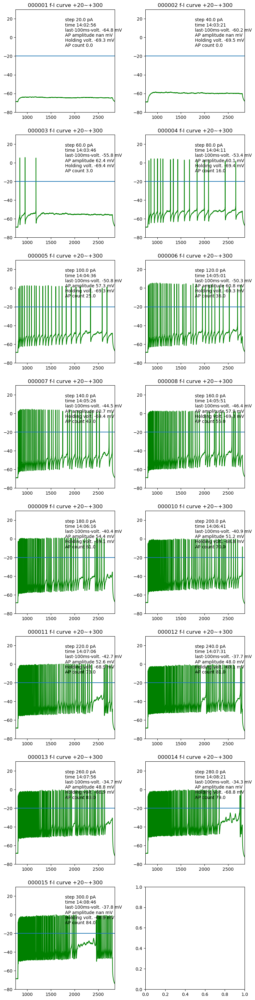




Neuron information:
           date  slice id  state
325  2018-04-04  Slice1c6  6ohda


filename:    2018-04-04_NS     2018-04-04 Slice1c6fI.hdf5    bias current:-100.0 pA
  Avg. AP amplitude (mV) 44.0


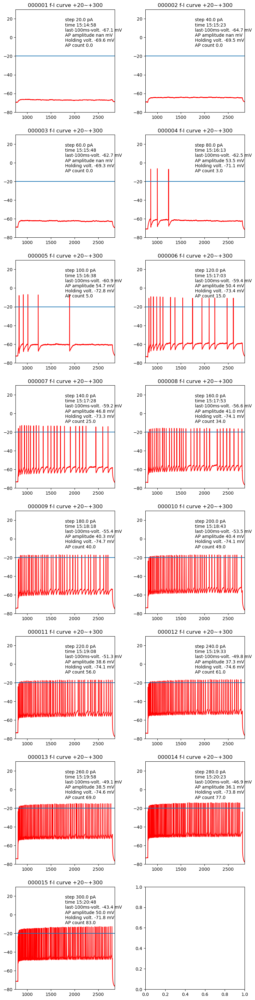




Neuron information:
           date  slice id  state
340  2018-07-18  Slice1c1  6ohda


filename:    2018-07-18_NS     2018-07-18 Slice1c1 fI.hdf5    bias current:80.0 pA
  Avg. AP amplitude (mV) 65.5


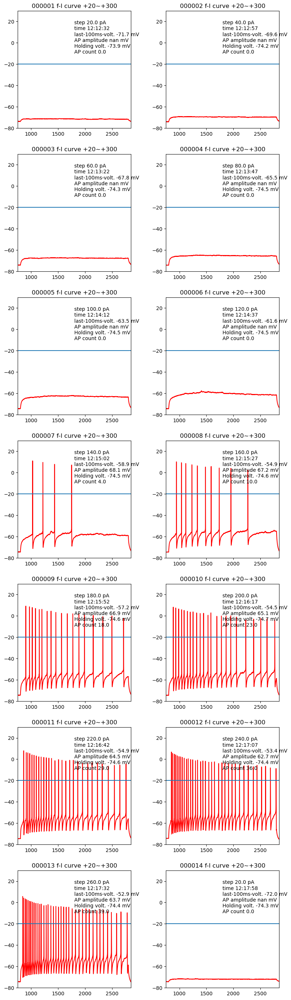






filename:    2018-07-18_NS     2018-07-18 Slice1c1 fI.hdf5    bias current:100.0 pA
  Avg. AP amplitude (mV) 63.2


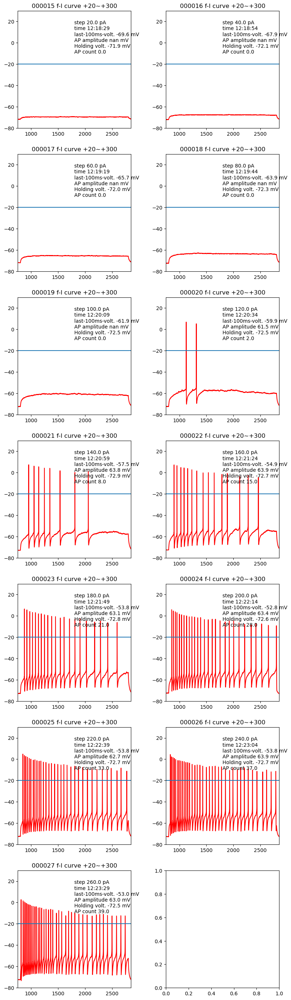






filename:    2018-07-18_NS     2018-07-18 Slice1c1 fI_2.hdf5    bias current:120.0 pA
  Avg. AP amplitude (mV) 52.3


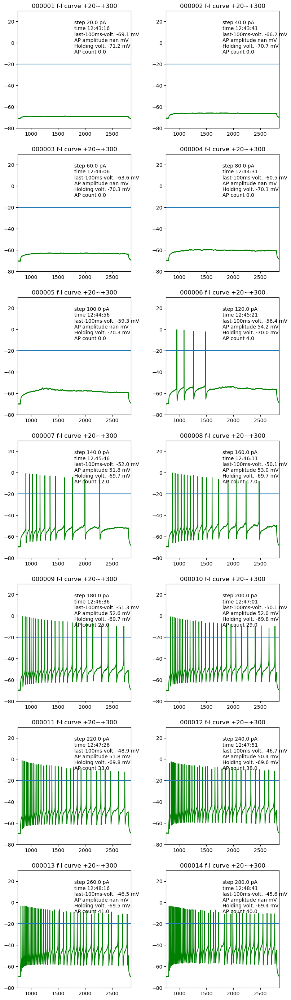






filename:    2018-07-18_NS     2018-07-18 Slice1c1 TBurst.hdf5    bias current:120.0 pA
  Avg. AP amplitude (mV) nan


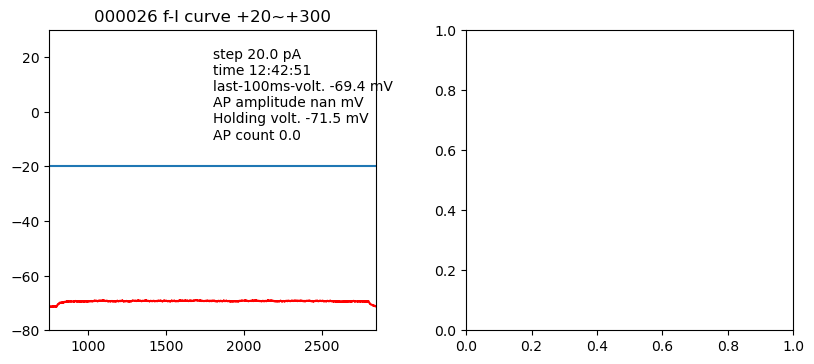




Neuron information:
           date  slice id  state
382  2018-07-18  Slice2c3  6ohda


filename:    2018-07-18_NS     2018-07-18 Slice2c3 fI_2.hdf5    bias current:90.0 pA
  Avg. AP amplitude (mV) 52.5


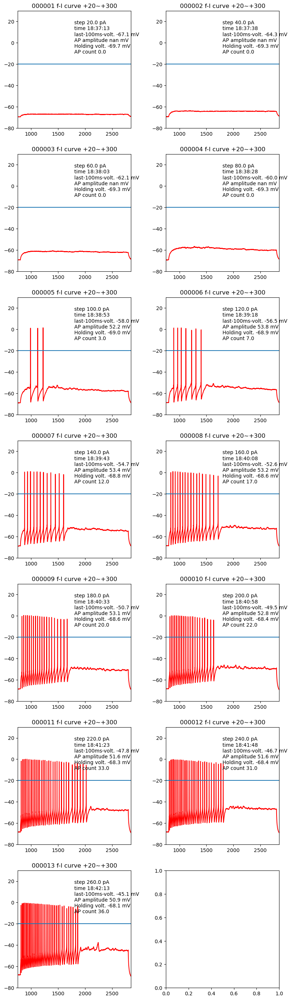






filename:    2018-07-18_NS     2018-07-18 Slice2c3fI.hdf5    bias current:50.0 pA
  Avg. AP amplitude (mV) 66.8


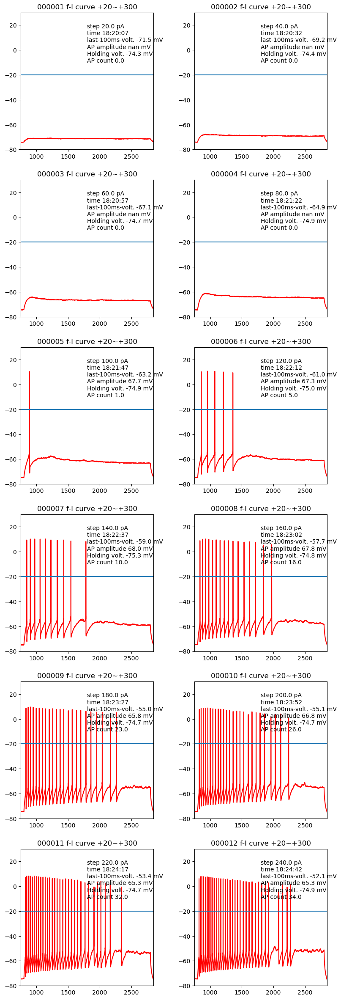






filename:    2018-07-18_NS     2018-07-18 Slice2c3fI.hdf5    bias current:90.0 pA
  Avg. AP amplitude (mV) 62.6


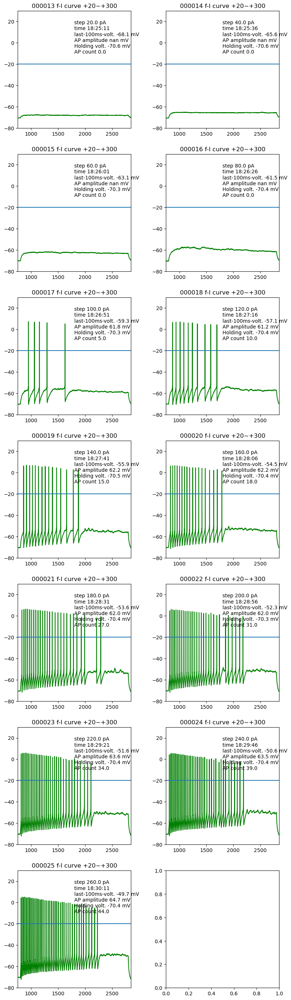




Neuron information:
           date  slice id  state
420  2018-07-25  Slice2c3  6ohda


filename:    2018-07-25_NS     2018-07-25 Slice2c3fI_2.hdf5    bias current:80.0 pA
  Avg. AP amplitude (mV) 28.3


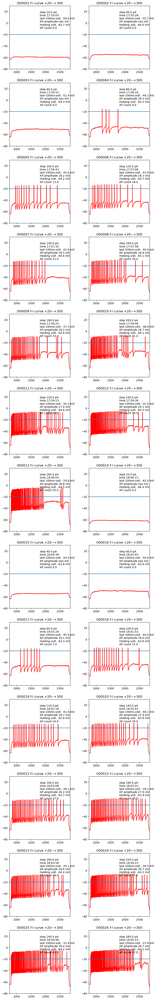






filename:    2018-07-25_NS     2018-07-25 Slice2c3fI.hdf5    bias current:100.0 pA
  Avg. AP amplitude (mV) 48.3


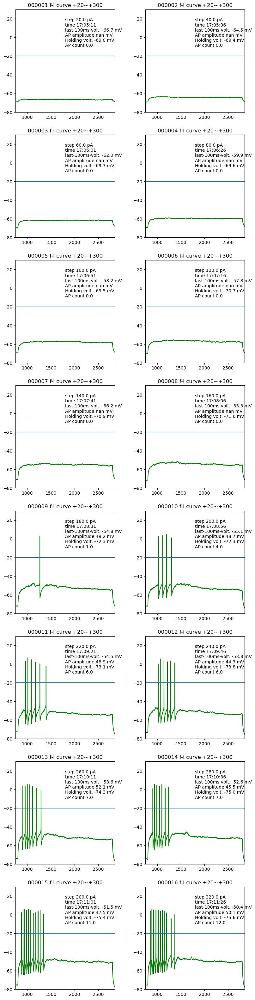






filename:    2018-07-25_NS     2018-07-25 Slice2c3fI.hdf5    bias current:150.0 pA
  Avg. AP amplitude (mV) 39.7


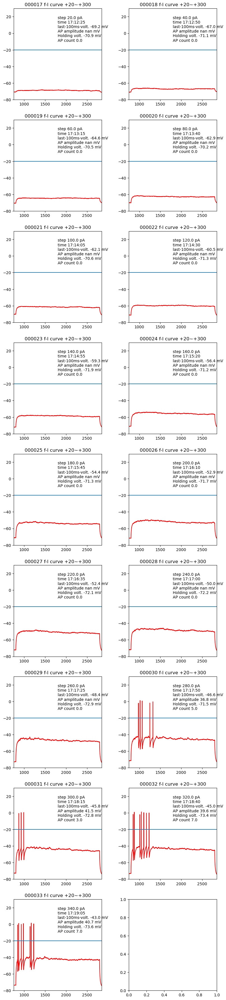




Neuron information:
           date  slice id  state
479  2018-07-25  Slice3c2  6ohda


filename:    2018-07-25_NS     2018-07-25 Slice3c2fI.hdf5    bias current:80.0 pA
  Avg. AP amplitude (mV) 52.6


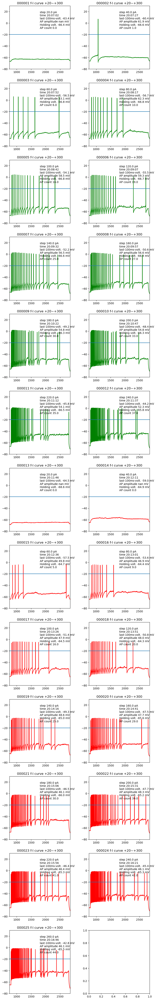




Neuron information:
           date  slice id  state
504  2018-07-25  Slice4c1  6ohda


filename:    2018-07-25_NS     2018-07-25 Slice4c1 fI_2.hdf5    bias current:50.0 pA
  Avg. AP amplitude (mV) 13.5


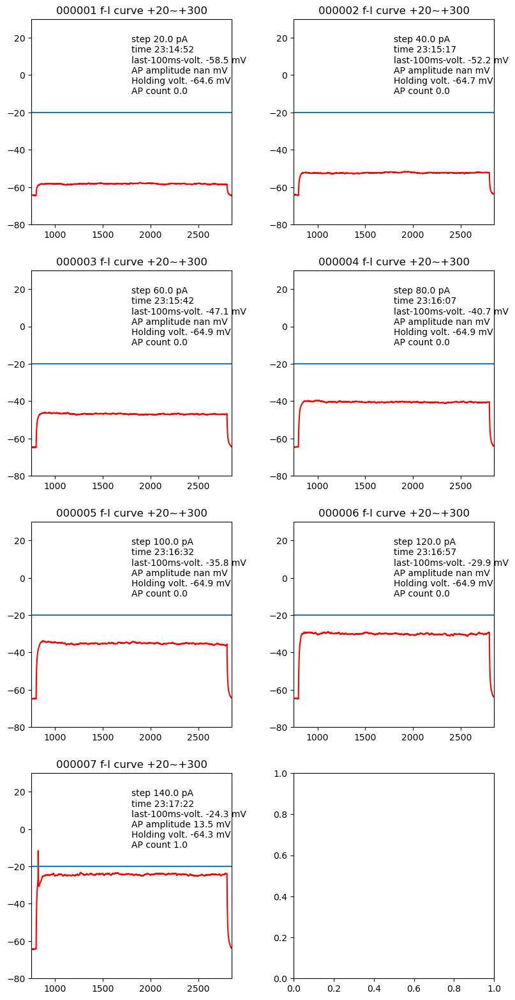






filename:    2018-07-25_NS     2018-07-25 Slice4c1 fI.hdf5    bias current:40.0 pA
  Avg. AP amplitude (mV) 45.6


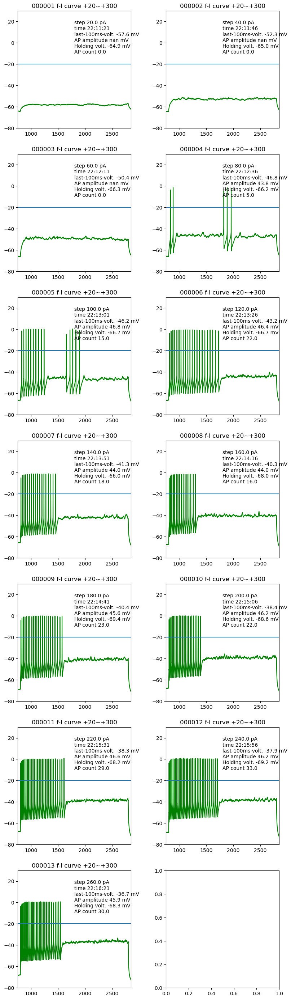






filename:    2018-07-25_NS     2018-07-25 Slice4c1 fI.hdf5    bias current:60.0 pA
  Avg. AP amplitude (mV) 36.1


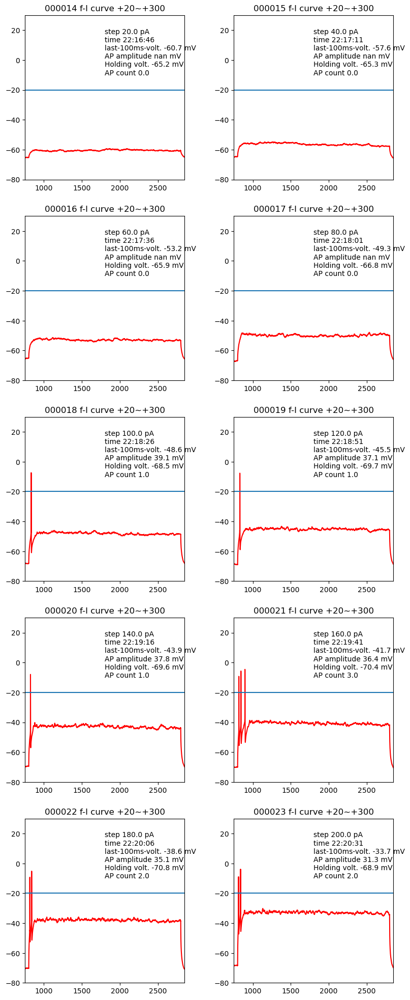






filename:    2018-07-25_NS     2018-07-25 Slice4c1 fI.hdf5    bias current:80.0 pA
  Avg. AP amplitude (mV) 28.7


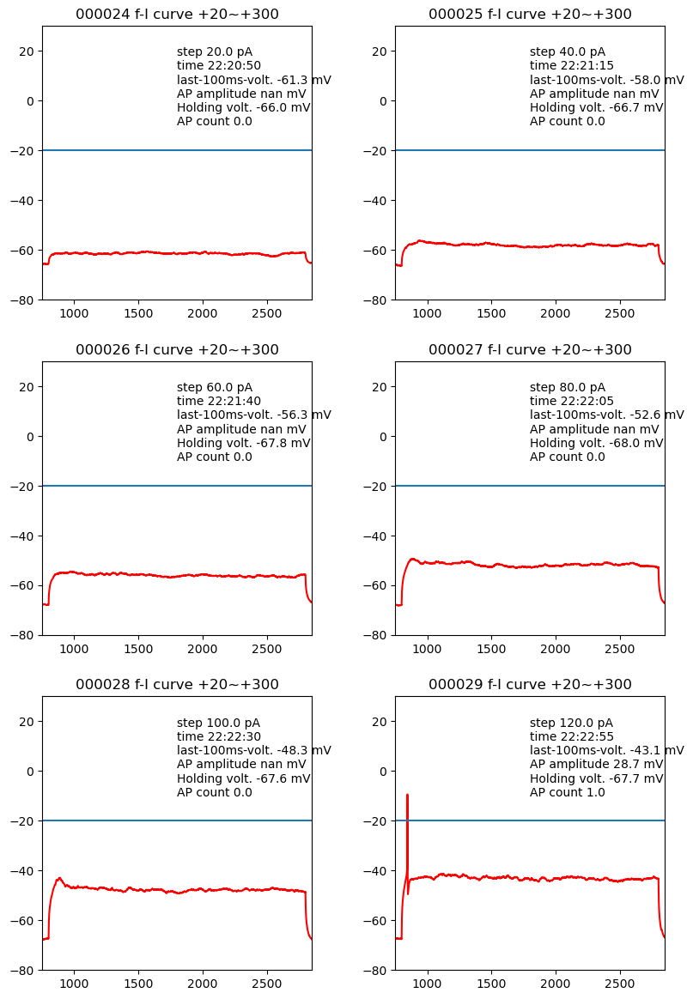




Neuron information:
           date  slice id  state
540  2018-08-03  Slice1c2  6ohda


filename:    2018-08-03_NS     2018-08-03 Slice1c2 fI.hdf5    bias current:20.0 pA
  Avg. AP amplitude (mV) 35.3


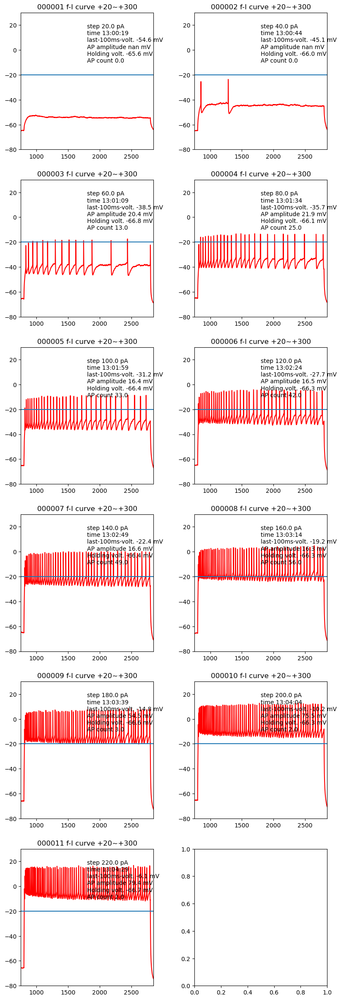




Neuron information:
           date  slice id  state
551  2018-08-03  Slice1c3  6ohda


filename:    2018-08-03_NS     2018-08-03 Slice1c3 fI.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) 64.3


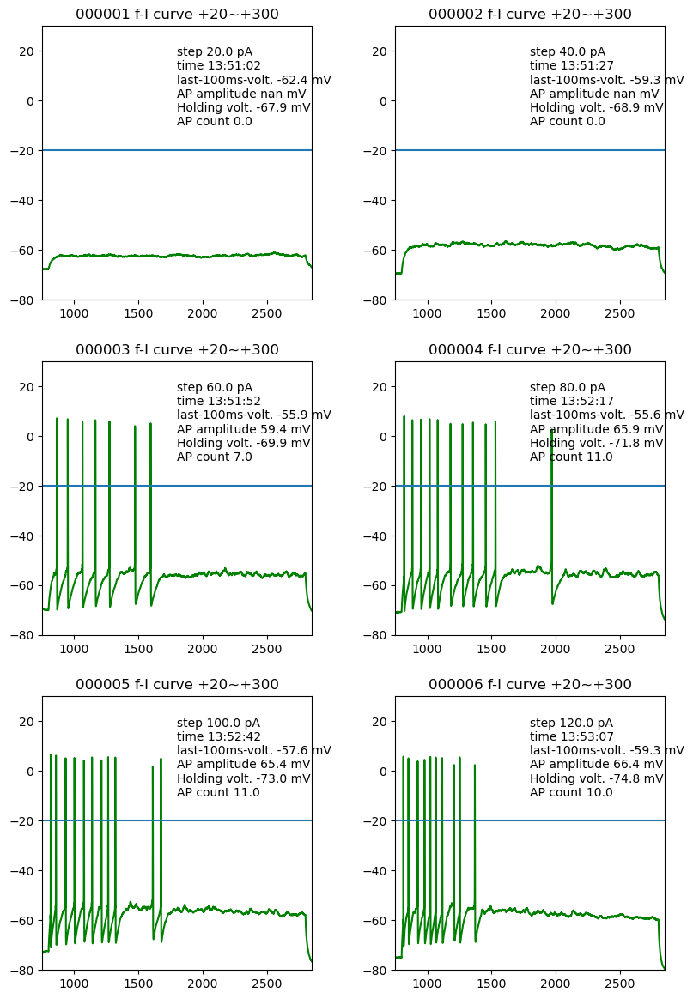






filename:    2018-08-03_NS     2018-08-03 Slice1c3 fI.hdf5    bias current:150.0 pA
  Avg. AP amplitude (mV) 66.3


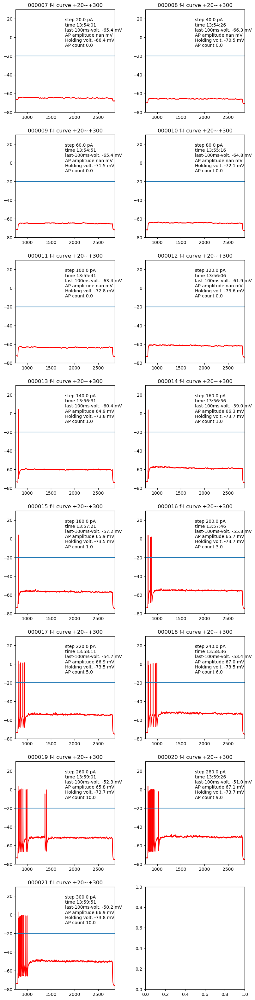






filename:    2018-08-03_NS     2018-08-03 Slice1c3 fI.hdf5    bias current:250.0 pA
  Avg. AP amplitude (mV) 58.3


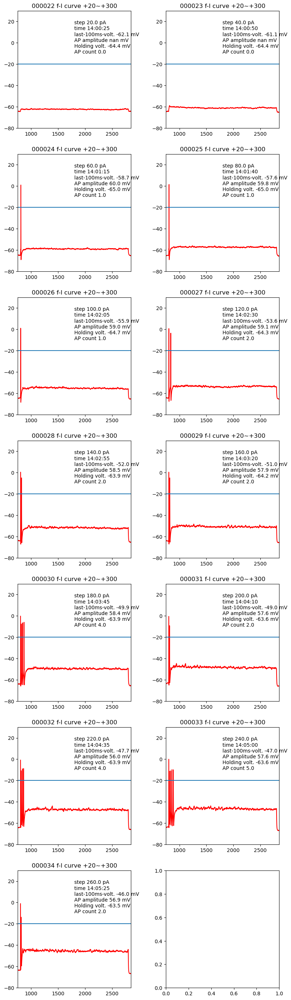






filename:    2018-08-03_NS     2018-08-03 Slice1c3 fI_3.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) nan


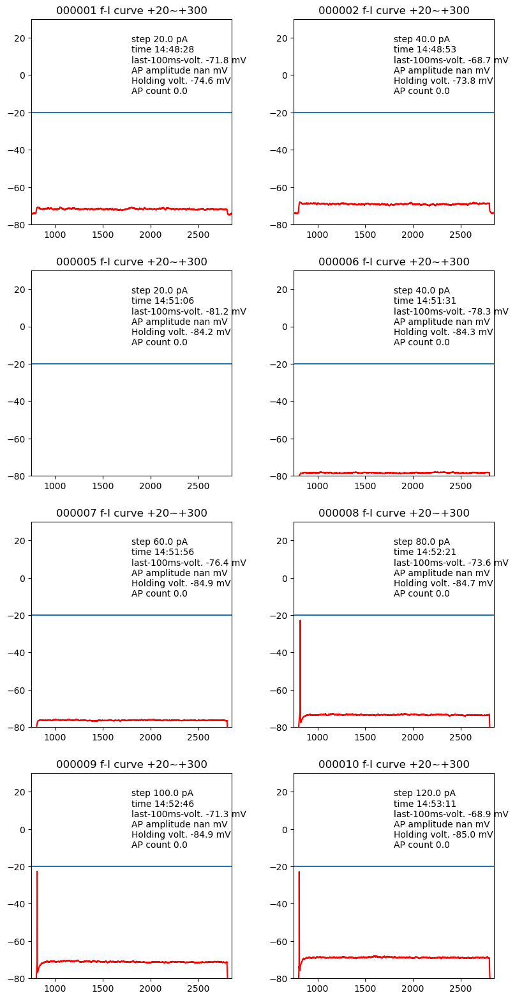






filename:    2018-08-03_NS     2018-08-03 Slice1c3 fI_3.hdf5    bias current:100.0 pA
  Avg. AP amplitude (mV) nan


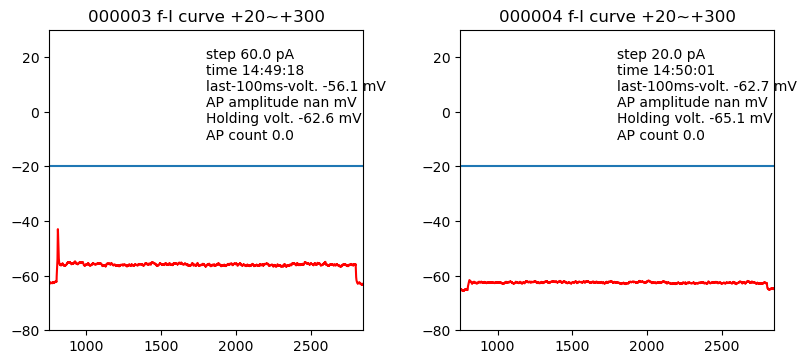






filename:    2018-08-03_NS     2018-08-03 Slice1c3 fI_4.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) nan


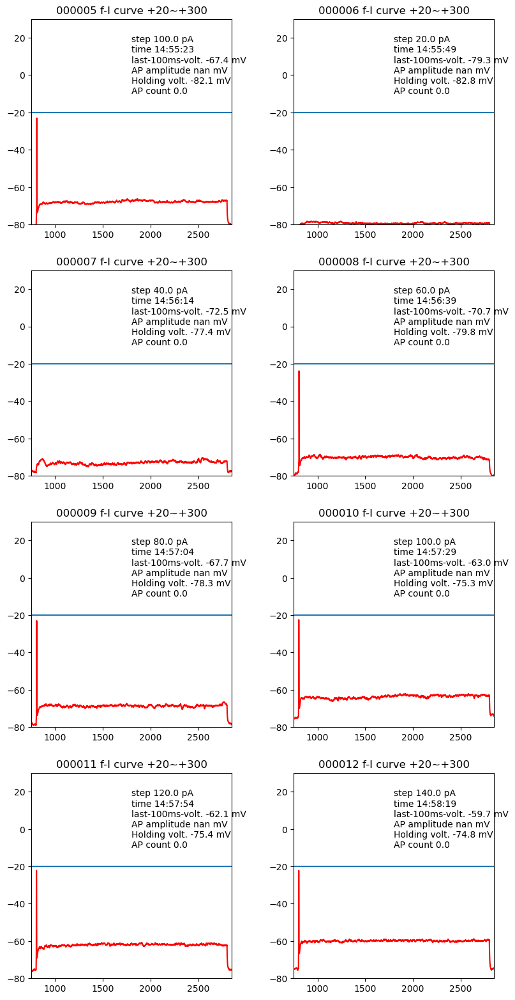






filename:    2018-08-03_NS     2018-08-03 Slice1c3 fI_4.hdf5    bias current:150.0 pA
  Avg. AP amplitude (mV) nan


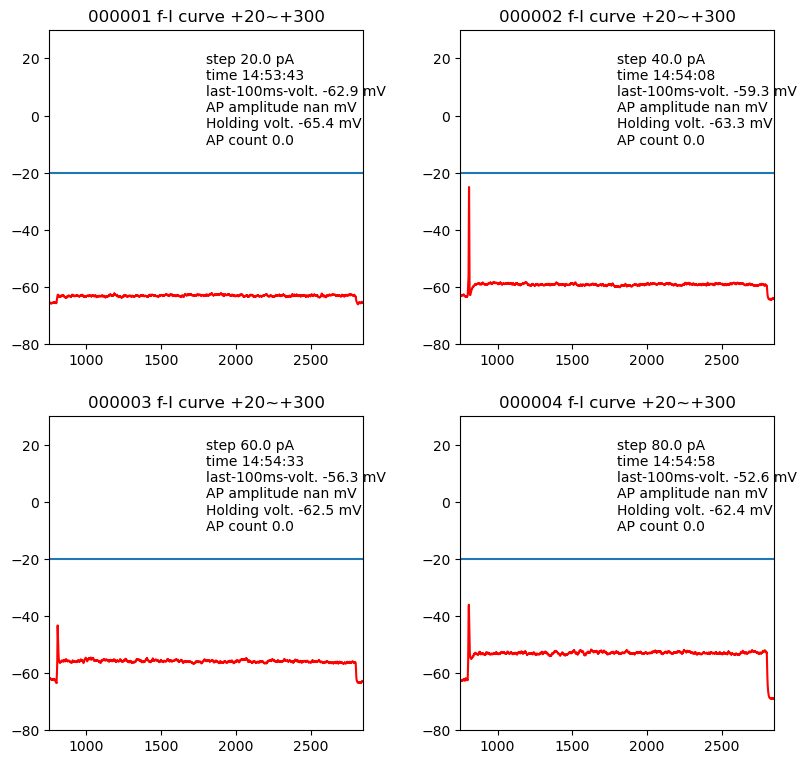




Neuron information:
           date  slice id  state
607  2018-08-03  Slice2c2  6ohda


filename:    2018-08-03_NS     2018-08-03 Slice2c2 fI.hdf5    bias current:50.0 pA
  Avg. AP amplitude (mV) 32.8


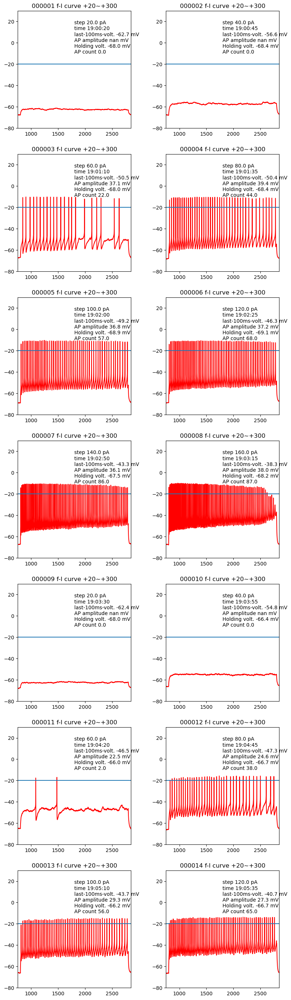




Neuron information:
           date  slice id  state
187  2019-03-07  Slice1c1  6ohda


filename:    2019-03-07_NS     2019-03-07 Slice1c1.hdf5    bias current:-300.0 pA
  Avg. AP amplitude (mV) 32.8


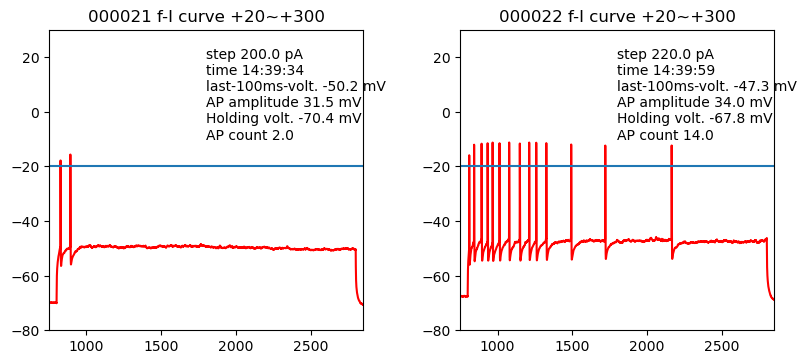






filename:    2019-03-07_NS     2019-03-07 Slice1c1.hdf5    bias current:-200.0 pA
  Avg. AP amplitude (mV) 54.3


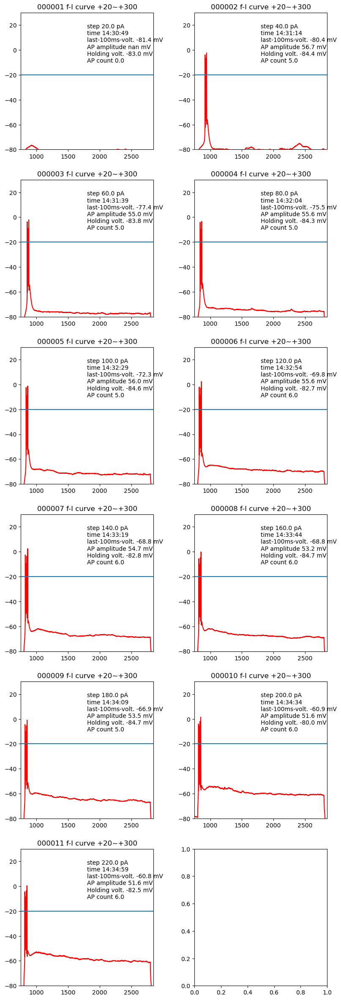






filename:    2019-03-07_NS     2019-03-07 Slice1c1.hdf5    bias current:-70.0 pA
  Avg. AP amplitude (mV) 42.3


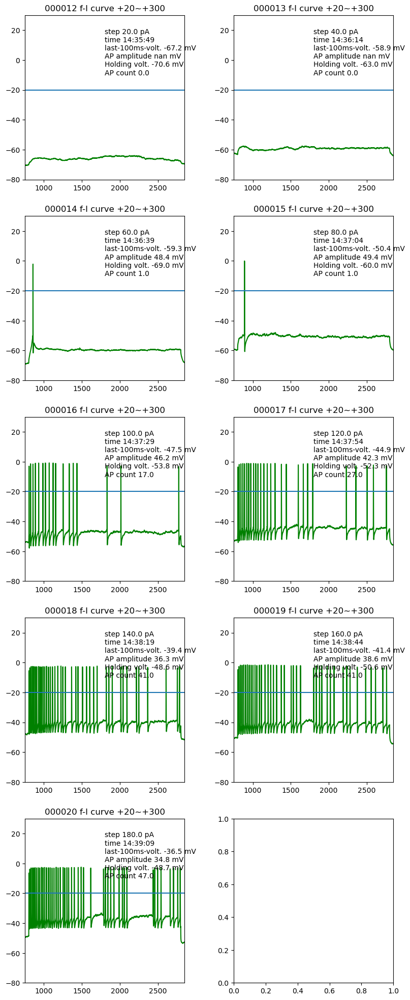




Neuron information:
           date  slice id  state
106  2019-03-07  Slice1c2  6ohda


filename:    2019-03-07_NS     2019-03-07 Slice1c2.hdf5    bias current:-50.0 pA
  Avg. AP amplitude (mV) 70.1


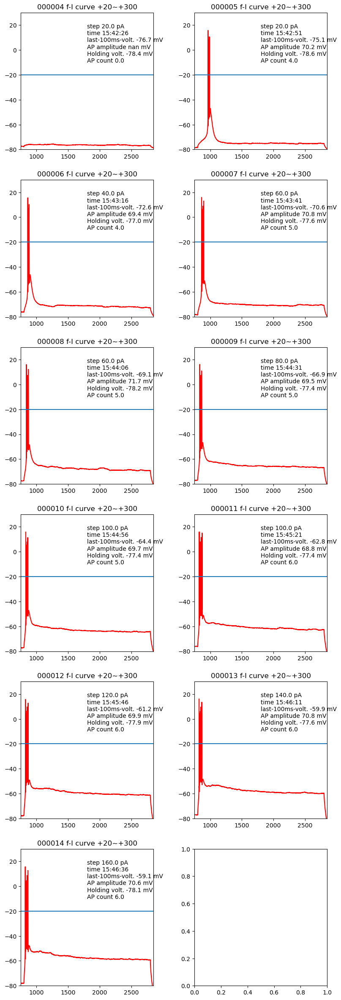






filename:    2019-03-07_NS     2019-03-07 Slice1c2.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) 69.6


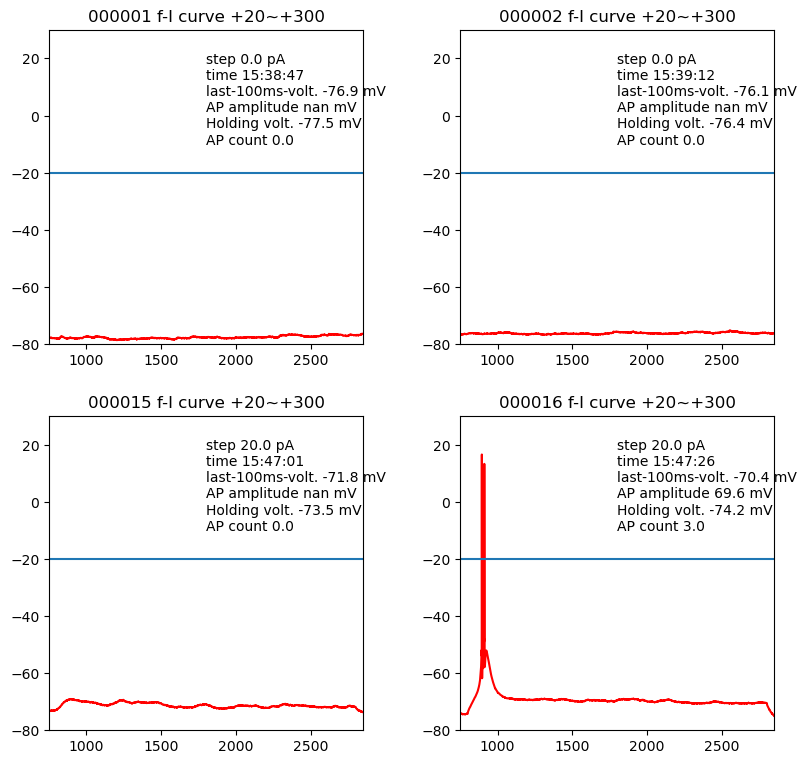






filename:    2019-03-07_NS     2019-03-07 Slice1c2.hdf5    bias current:10.0 pA
  Avg. AP amplitude (mV) 70.1


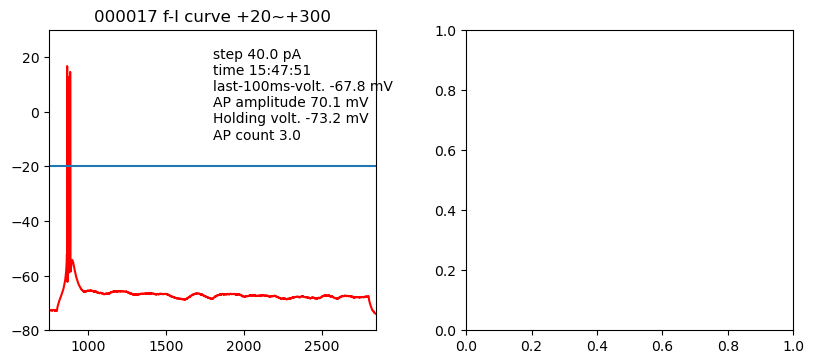






filename:    2019-03-07_NS     2019-03-07 Slice1c2.hdf5    bias current:20.0 pA
  Avg. AP amplitude (mV) 70.7


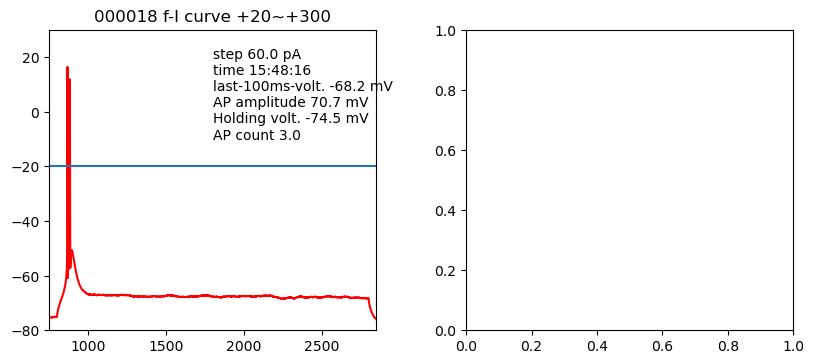






filename:    2019-03-07_NS     2019-03-07 Slice1c2.hdf5    bias current:30.0 pA
  Avg. AP amplitude (mV) 68.2


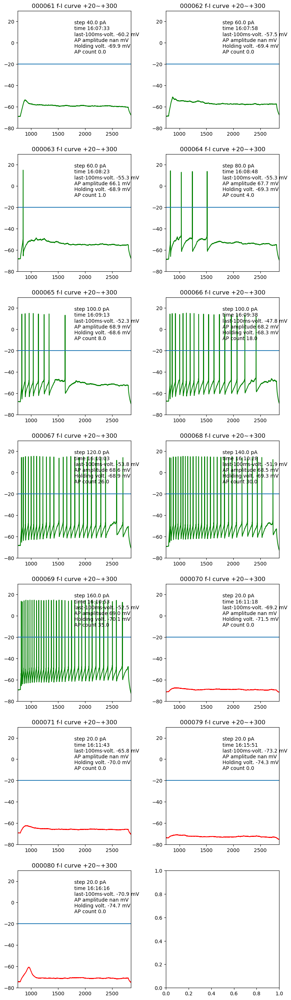






filename:    2019-03-07_NS     2019-03-07 Slice1c2.hdf5    bias current:50.0 pA
  Avg. AP amplitude (mV) 69.2


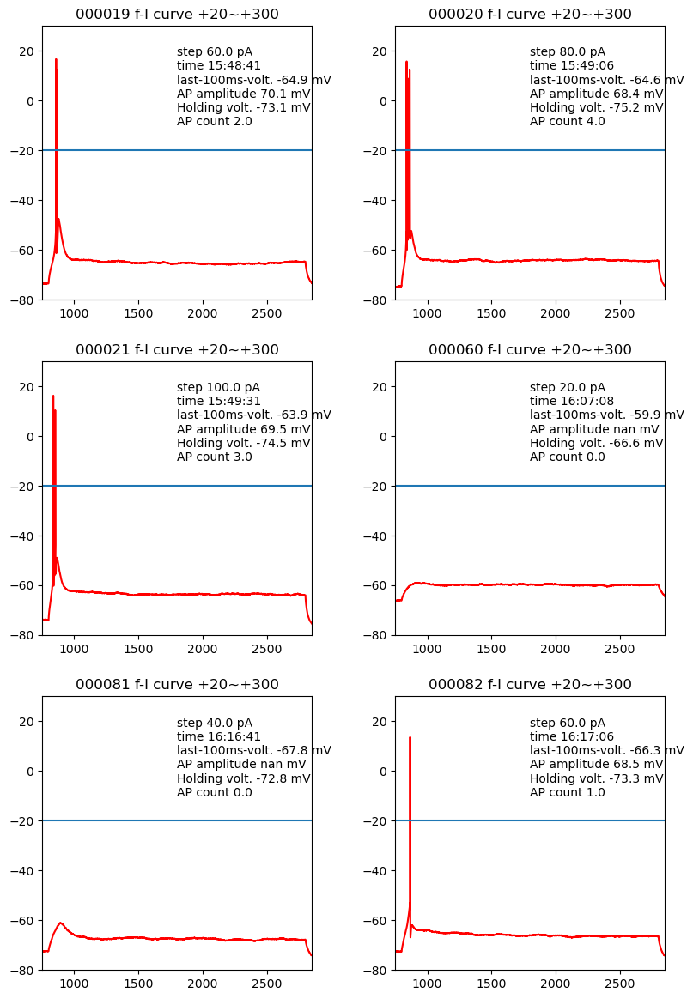






filename:    2019-03-07_NS     2019-03-07 Slice1c2.hdf5    bias current:70.0 pA
  Avg. AP amplitude (mV) 68.4


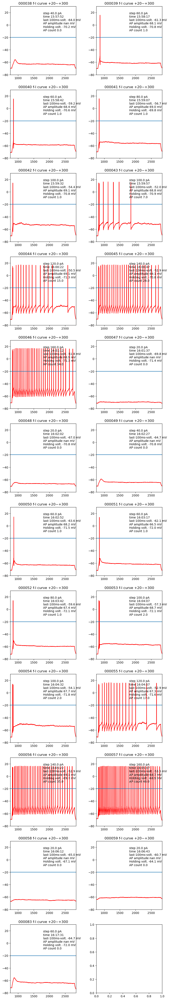






filename:    2019-03-07_NS     2019-03-07 Slice1c2.hdf5    bias current:80.0 pA
  Avg. AP amplitude (mV) nan


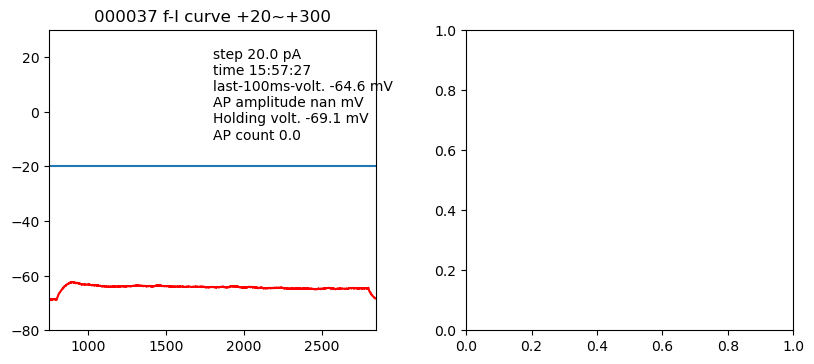






filename:    2019-03-07_NS     2019-03-07 Slice1c2.hdf5    bias current:90.0 pA
  Avg. AP amplitude (mV) nan


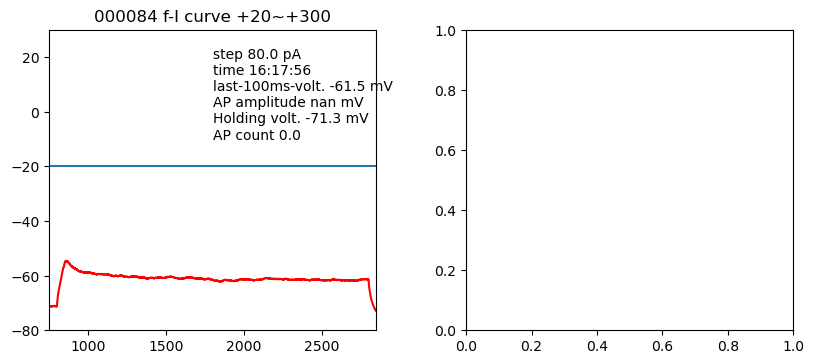






filename:    2019-03-07_NS     2019-03-07 Slice1c2.hdf5    bias current:100.0 pA
  Avg. AP amplitude (mV) 68.3


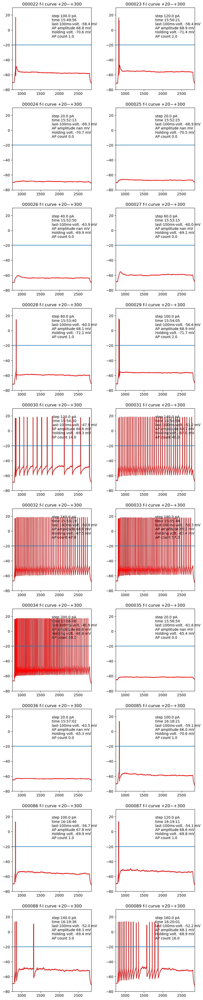




Neuron information:
          date  slice id  state
88  2019-03-07  Slice2c1  6ohda


filename:    2019-03-07_NS     2019-03-07 Slice2c1.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) 53.6


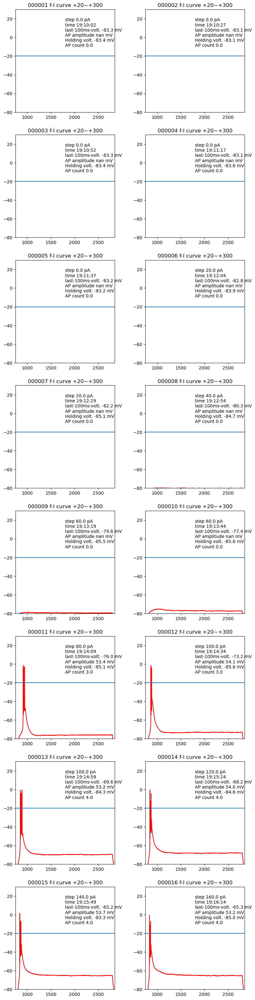






filename:    2019-03-07_NS     2019-03-07 Slice2c1.hdf5    bias current:100.0 pA
  Avg. AP amplitude (mV) nan


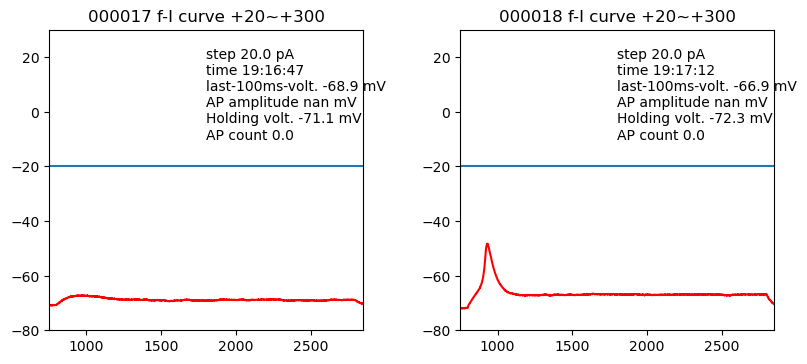




Neuron information:
          date  slice id  state
13  2019-05-10  Slice1c1  6ohda


filename:    2019-05-10_NS     2019-05-10 Slice1c1.hdf5    bias current:-20.0 pA
  Avg. AP amplitude (mV) 44.7


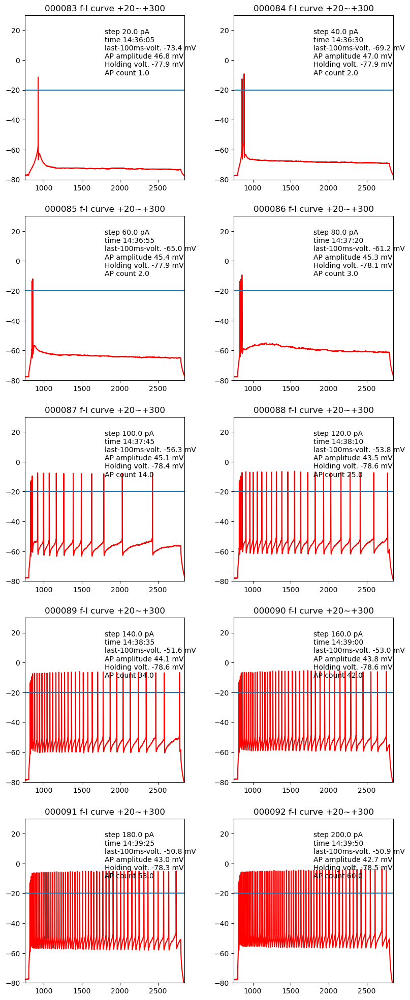






filename:    2019-05-10_NS     2019-05-10 Slice1c1.hdf5    bias current:-10.0 pA
  Avg. AP amplitude (mV) 54.0


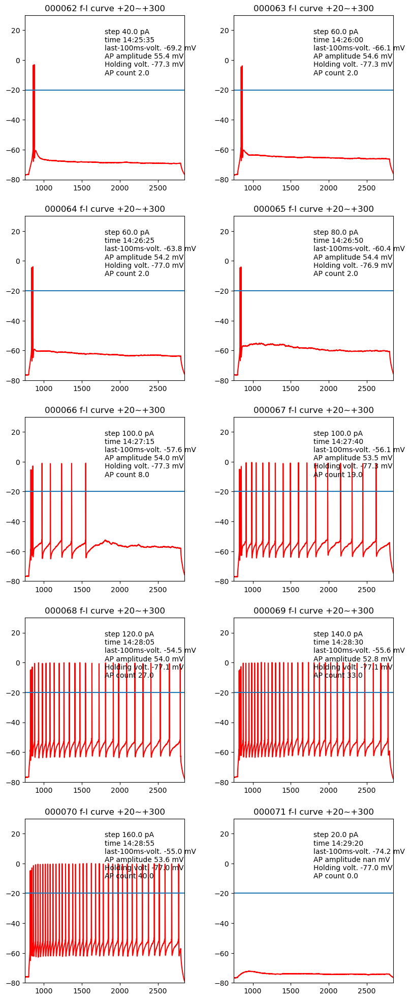






filename:    2019-05-10_NS     2019-05-10 Slice1c1.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) 59.3


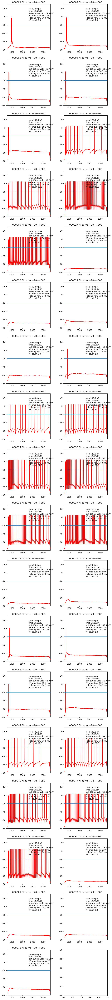






filename:    2019-05-10_NS     2019-05-10 Slice1c1.hdf5    bias current:10.0 pA
  Avg. AP amplitude (mV) 50.6


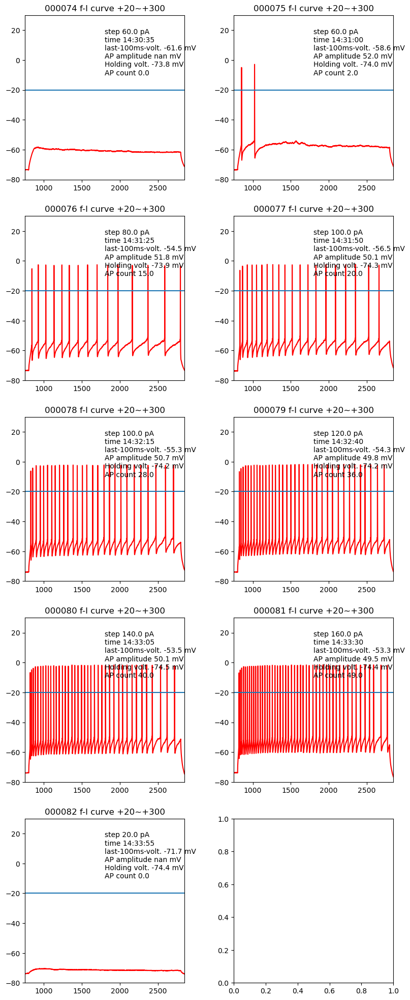






filename:    2019-05-10_NS     2019-05-10 Slice1c1.hdf5    bias current:20.0 pA
  Avg. AP amplitude (mV) 58.2


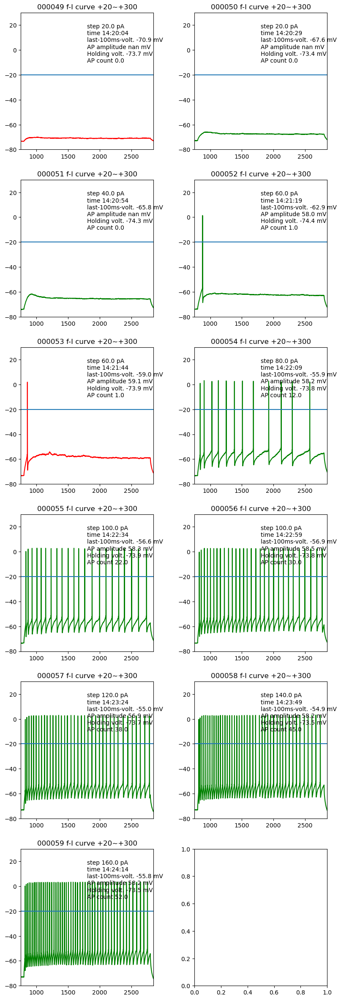




Neuron information:
         date  slice id  state
0  2019-05-10  Slice2c1  6ohda


filename:    2019-05-10_NS     2019-05-10 Slice2c1.hdf5    bias current:0.0 pA
  Avg. AP amplitude (mV) 42.4


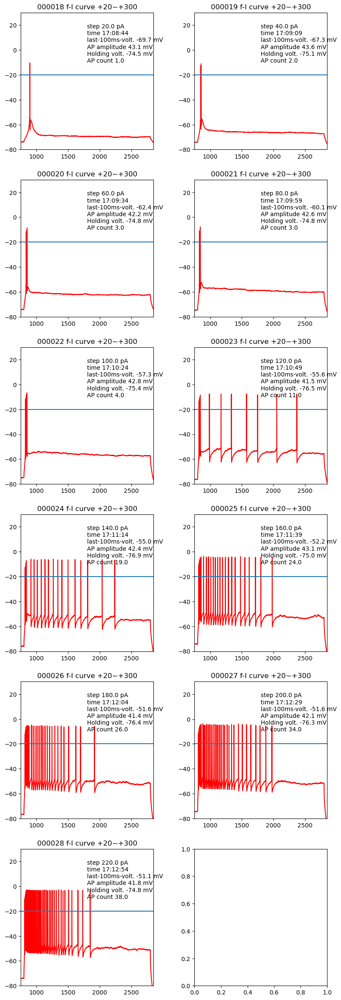






filename:    2019-05-10_NS     2019-05-10 Slice2c1.hdf5    bias current:20.0 pA
  Avg. AP amplitude (mV) nan


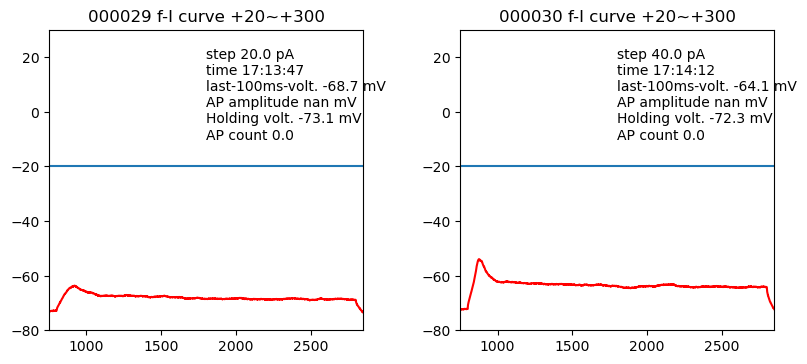




-----------------------------------------------------------------------------------------




In [5]:
# neuron index
print ('6ohda')
print ('-----------------------------------------------------------------------------------------')
data_lesioned = data[data['state'] == '6ohda']
n = data_lesioned[['date', 'slice id']].drop_duplicates().shape[0]
for i in range(n):
    run_plotting(data_lesioned, i)
print ('-----------------------------------------------------------------------------------------\n\n')